In [1]:
seed_num = 2022

from numpy.random import seed
seed(seed_num)
from tensorflow.random import set_seed
set_seed(seed_num)
import tensorflow as tf
tf.keras.utils.set_random_seed(seed_num)
tf.config.experimental.enable_op_determinism()

import os
import numpy as np
import pandas as pd
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt
import matplotlib.lines as mlines
from IPython.display import clear_output
from time import time
import anndata as ad
import seaborn as sns
import scanpy as sc
from scipy import stats

from matplotlib import pyplot as plt
import seaborn as sns

from SC2Spa import SI, PP, Vis, SVA

pd.set_option('display.max_columns', None)
%matplotlib inline

/mnt/win1
/mnt/win1/SC2Spa_Notebook/MouseHippocampus_SSV2


# Load

In [2]:
#Load
adata_ref = ad.read_h5ad('../Dataset/AdataMH1.h5ad')
adata_query = ad.read_h5ad('../Dataset/AdataMH2.h5ad')

adata_ref.var_names = adata_ref.var_names.str.upper()
adata_query.var_names = adata_query.var_names.str.upper()

adata_ref.var_names_make_unique()
adata_query.var_names_make_unique()

#Normalize
sc.pp.normalize_total(adata_ref, target_sum=1e4)
sc.pp.normalize_total(adata_query, target_sum=1e4)

adata_ref.obsm['spatial'] = adata_ref.obs[['xcoord', 'ycoord']].values
adata_query.obsm['spatial'] = adata_query.obs[['xcoord', 'ycoord']].values
sc.pp.log1p(adata_ref)
sc.pp.log1p(adata_query)

Anno = pd.read_csv('ssHippo_RCTD.csv', index_col = 0)
Anno['MCT'] = 't'
index1 = Anno.index[(Anno['celltype_1'] == Anno['celltype_2'])]
Anno['MCT'][index1] = Anno['celltype_1'][index1]
index2 = Anno.index[(Anno['celltype_1'] != Anno['celltype_2'])]
Anno['MCT'][index2] = (Anno['celltype_1'][index2] + '_' + Anno['celltype_2'][index2]).apply(lambda x: '_'.join(sorted(set(x.split('_')))))

adata_ref.obs = adata_ref.obs.merge(Anno, left_index = True, right_index = True, how = 'left')

#Fine clustering
HC2_clustering = pd.read_csv('CellInfo/HC2_clustering_2.csv',index_col = 0)[['leiden']]
HC2_clustering.columns = ['leiden2']
adata_query.obs = adata_query.obs.merge(HC2_clustering, how = 'left', left_index = True, right_index = True)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


# FineMapping

In [3]:
sta = time()
JGs, WDs = SI.WassersteinD(adata_ref, adata_query, sparse = True,
                           WD_cutoff = 0.1, root = 'WDs/', save = 'WDs_T1')

end = time()
print((end - sta) / 60.0, 'min')

20.422908679644266 min


In [3]:
WD_cutoff = 0.1

root = 'WDs/'
save = 'WDs_T1'

WDs = pd.read_csv(root + save + '.csv')
JGs = sorted(WDs[WDs['Wasserstein_Distance'] < WD_cutoff]['Gene'].tolist())

adata_ref = adata_ref[:, JGs]
adata_query = adata_query[:, JGs]

'''
seed(seed_num)
set_seed(seed_num)
tf.keras.utils.set_random_seed(seed_num)

sta = time()

neighbors, dis = SI.FineMapping(adata_ref, adata_query, sparse =True, model_path = None, root = 'Model_SI/',
                               name = 'SI_T1_WD', l1_reg = 1e-5, l2_reg = 0, dropout = 0.05, epoch = 500,
                               batch_size = 4096, nodes = [4096, 1024, 256, 64, 16, 4], lrr_patience = 20,
                               ES_patience = 50, min_lr = 1e-5, save = True, polar = True,
                               n_neighbors = 1000, dis_cutoff = 20, seed = seed_num)

end = time()
print((end - sta) / 60.0, 'min')
'''
neighbors, dis = SI.FineMapping(adata_ref, adata_query, model_path = 'Model_SI/SI_T1_WD.h5', root = 'Model_SI/',
                                name = 'SI_T1_WD', polar = True, n_neighbors = 1000, dis_cutoff = 10)

n of Referece Genes: 18403
n of Target Genes: 18403
n of Selected Genes: 18403
(35349, 18403)
(16373, 18403)


2022-11-01 18:14:55.625234: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_COMPAT_NOT_SUPPORTED_ON_DEVICE: forward compatibility was attempted on non supported HW
2022-11-01 18:14:55.625310: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:169] retrieving CUDA diagnostic information for host: linbuliao-ThinkStation-P720
2022-11-01 18:14:55.625327: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:176] hostname: linbuliao-ThinkStation-P720
2022-11-01 18:14:55.625545: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:200] libcuda reported version is: 510.85.2
2022-11-01 18:14:55.625601: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:204] kernel reported version is: 510.73.5
2022-11-01 18:14:55.625615: E tensorflow/stream_executor/cuda/cuda_diagnostics.cc:313] kernel version 510.73.5 does not match DSO version 510.85.2 -- cannot find working devices in this configuration
2022-11-01 18:14:55.626157: I tensorflow/core/platform/cpu

In [3]:
'''
seed(seed_num)
set_seed(seed_num)
tf.keras.utils.set_random_seed(seed_num)

sta = time.time()

neighbors, dis = SI.FineMapping(adata_ref, adata_query, sparse =True, model_path = None, root = 'Model_SI/',
                               name = 'SI_T1', l1_reg = 1e-5, l2_reg = 0, dropout = 0.05, epoch = 500,
                               batch_size = 4096, nodes = [4096, 1024, 256, 64, 16, 4],
                               lrr_patience = 20, ES_patience = 50, min_lr = 1e-5, save = True, polar = True,
                               n_neighbors = 1000, dis_cutoff = 20, seed = seed_num)

end = time.time()
print((end - sta) / 60.0, 'min')

'''
neighbors, dis = SI.FineMapping(adata_ref, adata_query, model_path = 'Model_SI/SI_T1.h5', root = 'Model_SI/',
                                name = 'SI_T1', polar = True, n_neighbors = 1000, dis_cutoff = 10)

n of Referece Genes: 20527
n of Target Genes: 19227
n of Selected Genes: 18757
(35349, 18757)
(16373, 18757)


2022-11-03 20:34:51.421301: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_COMPAT_NOT_SUPPORTED_ON_DEVICE: forward compatibility was attempted on non supported HW
2022-11-03 20:34:51.421413: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:169] retrieving CUDA diagnostic information for host: linbuliao-ThinkStation-P720
2022-11-03 20:34:51.421439: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:176] hostname: linbuliao-ThinkStation-P720
2022-11-03 20:34:51.421729: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:200] libcuda reported version is: 510.85.2
2022-11-03 20:34:51.421806: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:204] kernel reported version is: 510.73.5
2022-11-03 20:34:51.421828: E tensorflow/stream_executor/cuda/cuda_diagnostics.cc:313] kernel version 510.73.5 does not match DSO version 510.85.2 -- cannot find working devices in this configuration
2022-11-03 20:34:51.422731: I tensorflow/core/platform/cpu

# Visualize Cell Type(Cluster) Locations

****************
16
****************
Transfer:


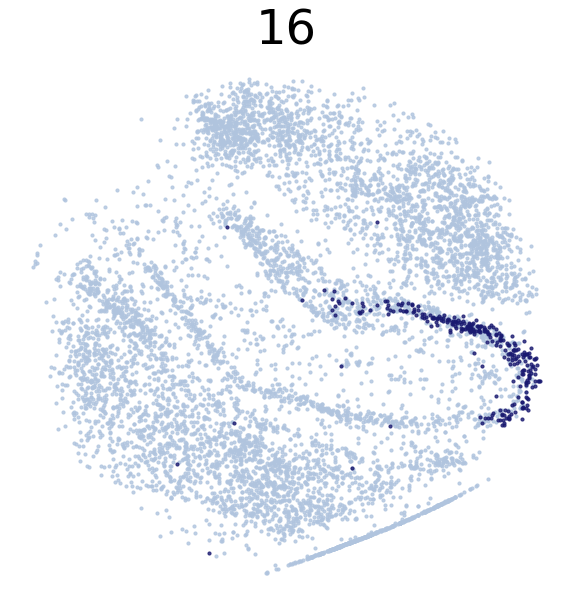

HC2:


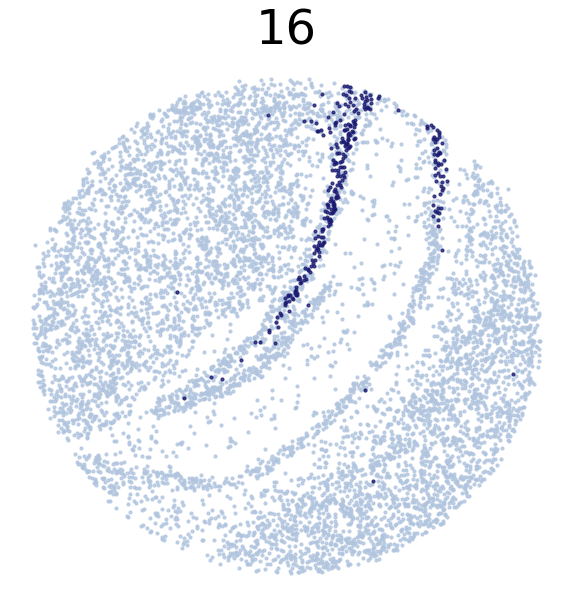

****************
11
****************
Transfer:


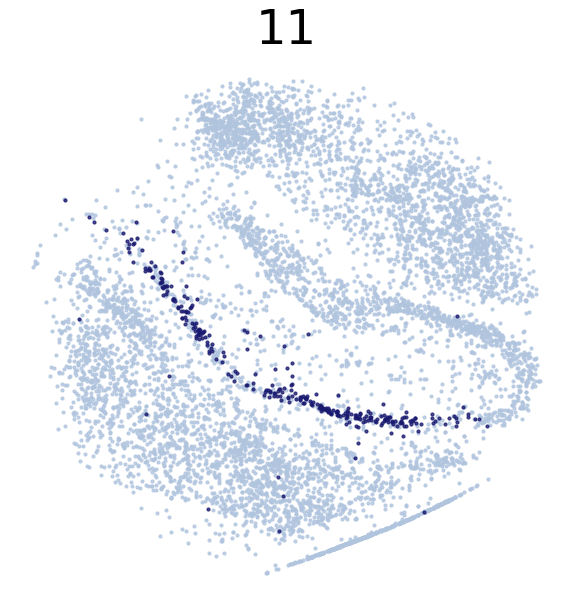

HC2:


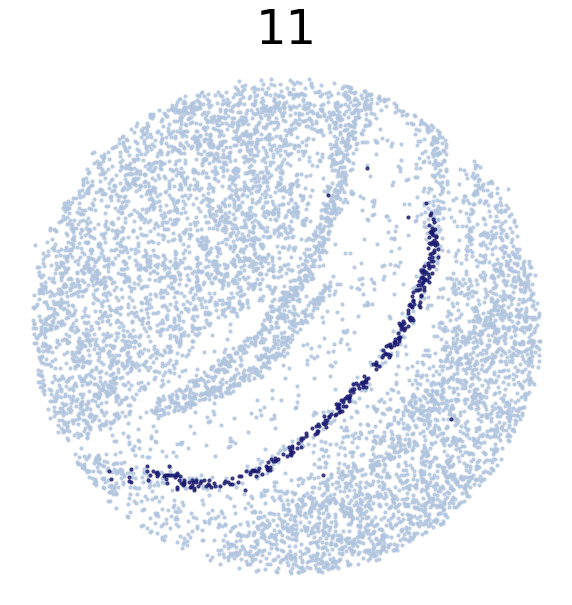

****************
0
****************
Transfer:


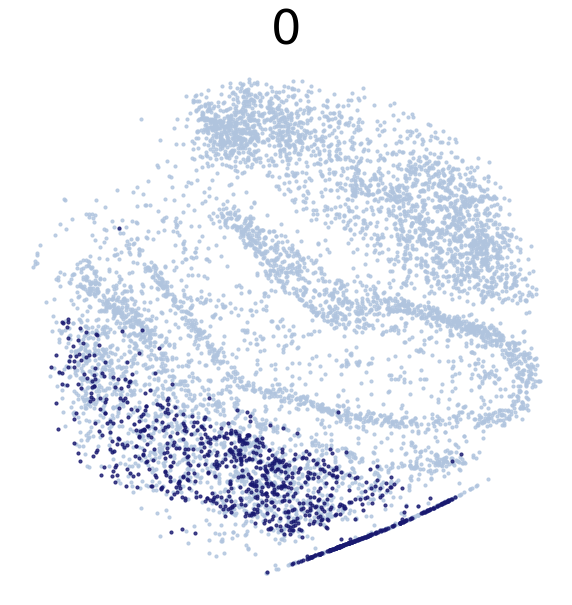

HC2:


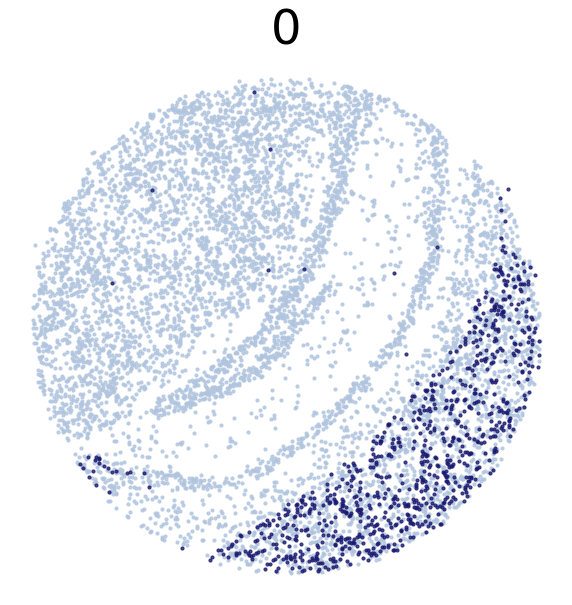

****************
13
****************
Transfer:


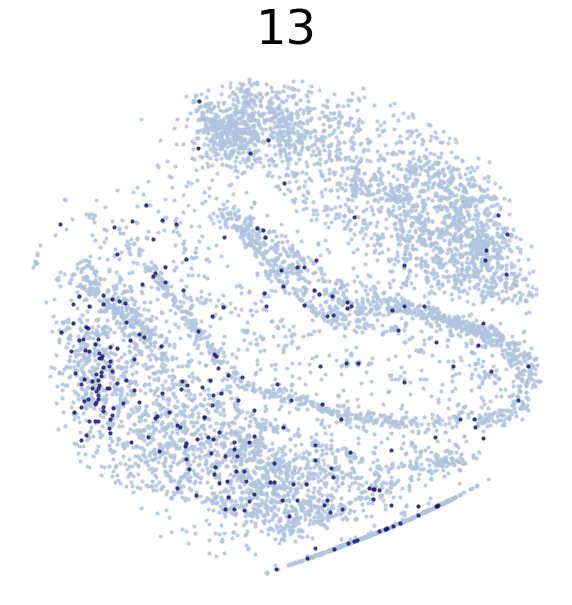

HC2:


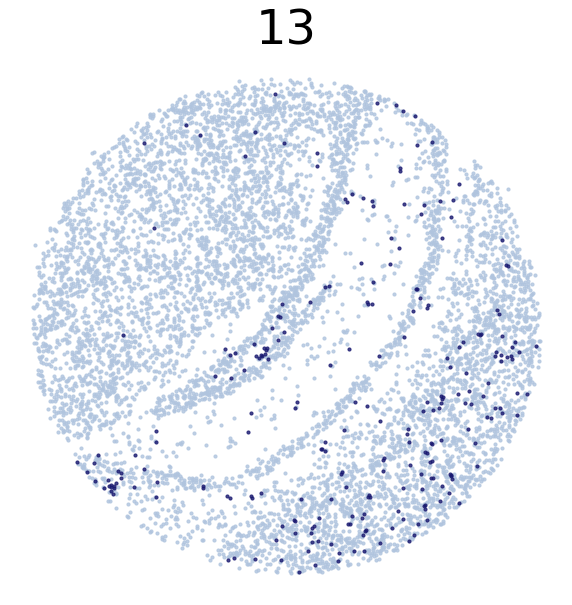

****************
4
****************
Transfer:


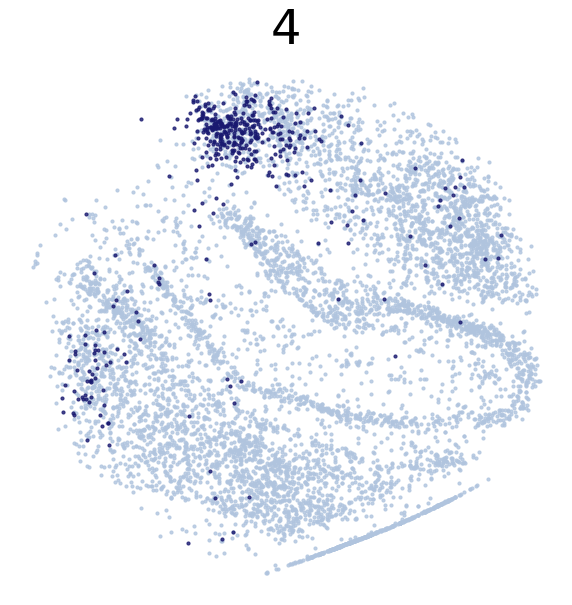

HC2:


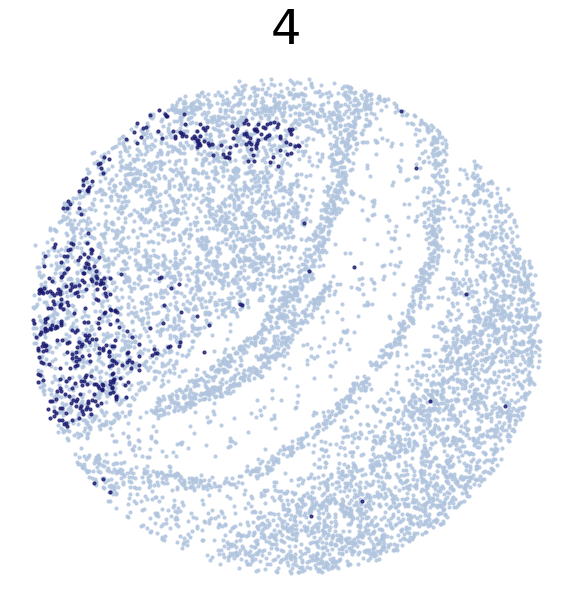

****************
20
****************
Transfer:


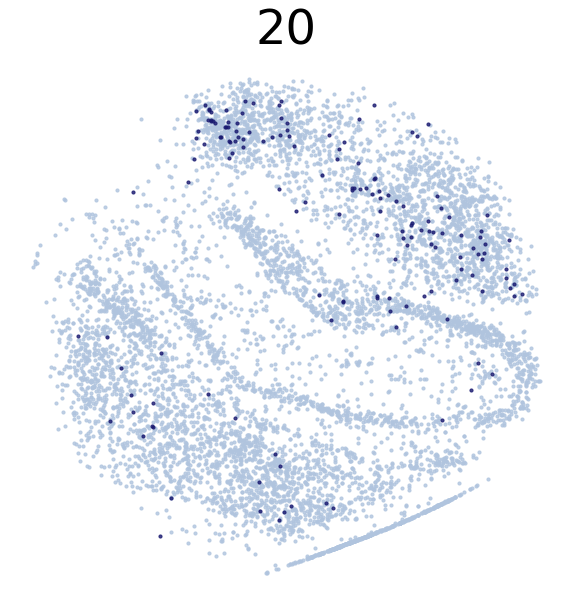

HC2:


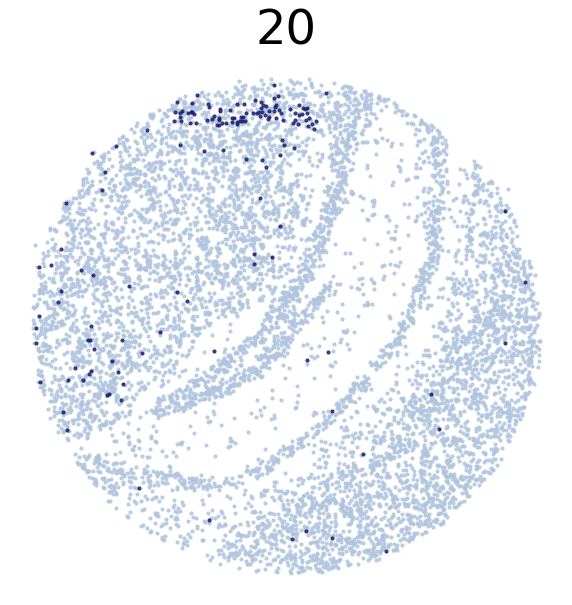

****************
12
****************
Transfer:


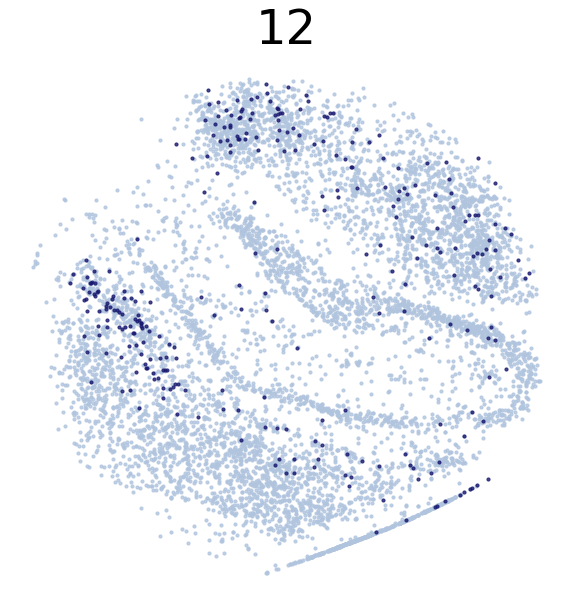

HC2:


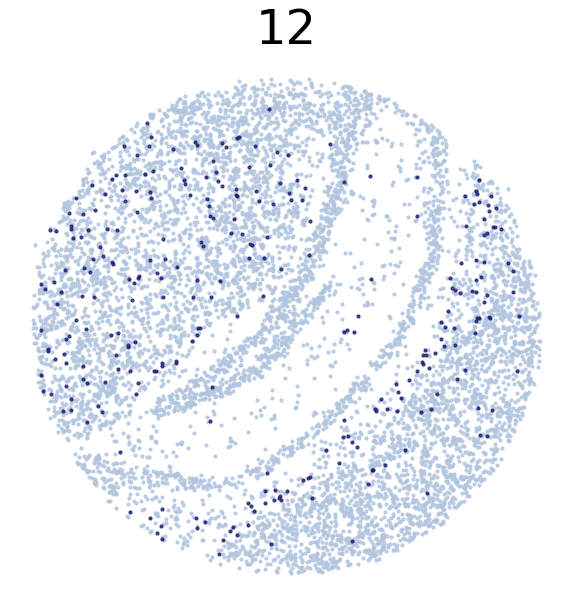

****************
14
****************
Transfer:


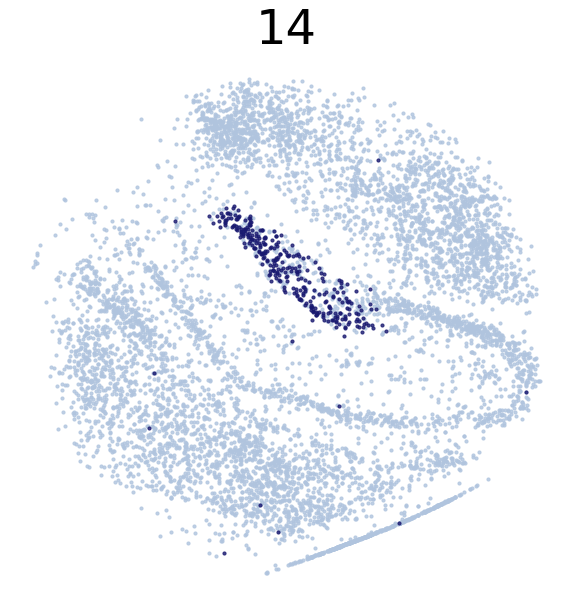

HC2:


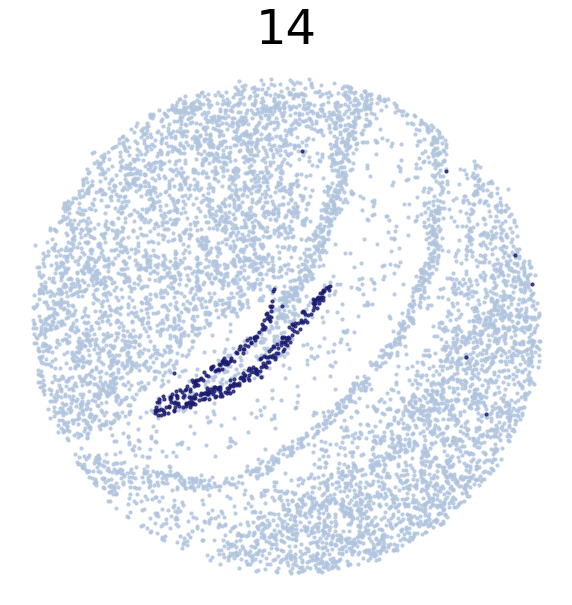

****************
19
****************
Transfer:


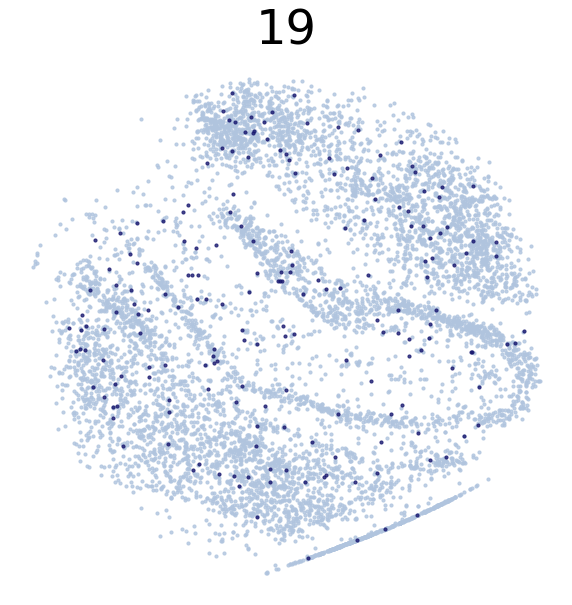

HC2:


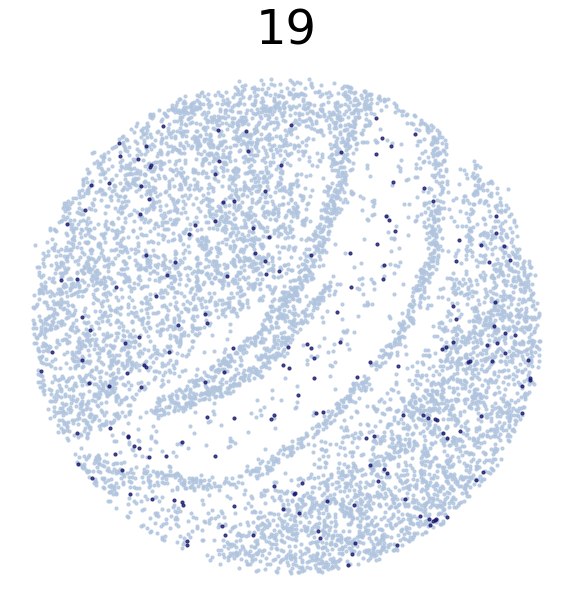

****************
10
****************
Transfer:


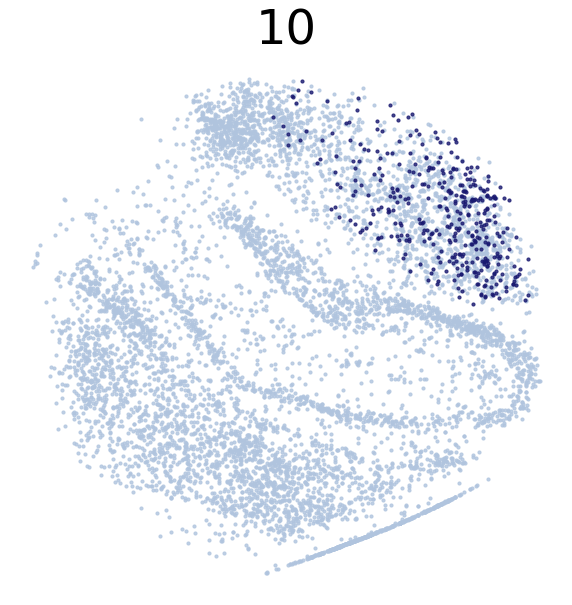

HC2:


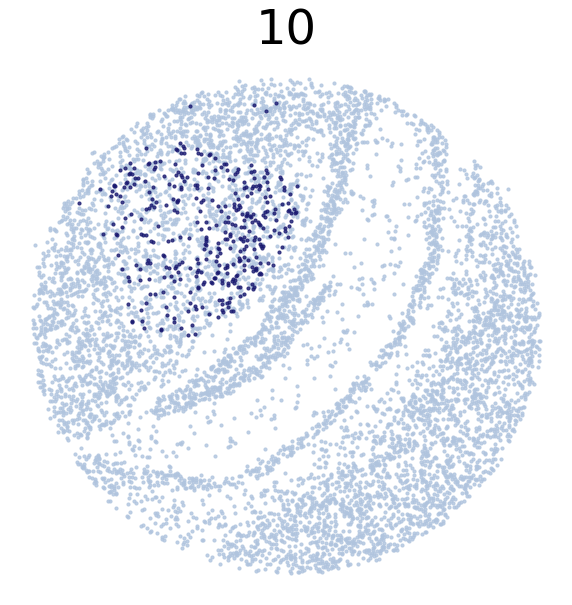

****************
24
****************
Transfer:


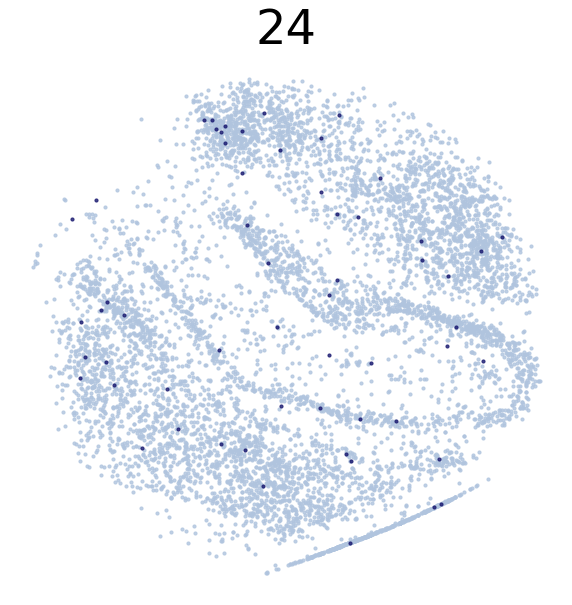

HC2:


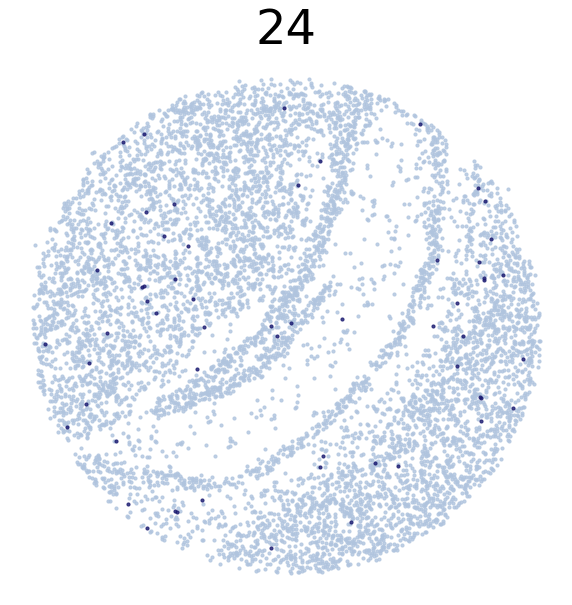

****************
21
****************
Transfer:


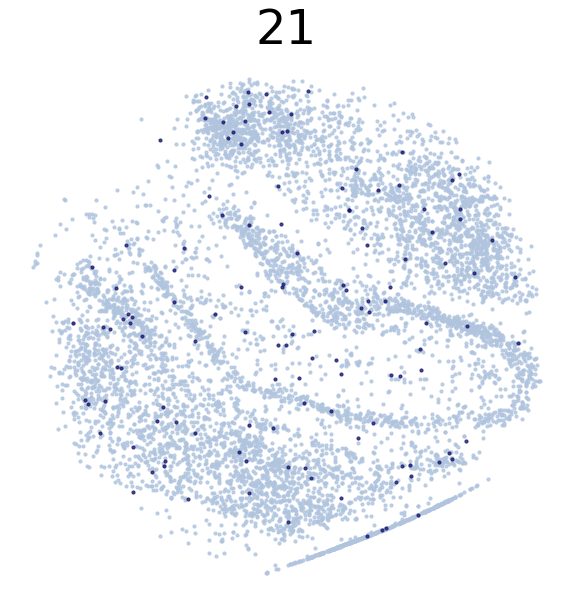

HC2:


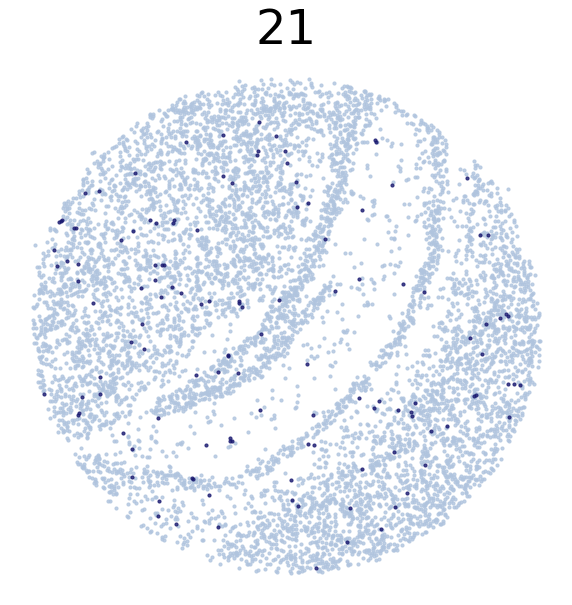

****************
22
****************
Transfer:


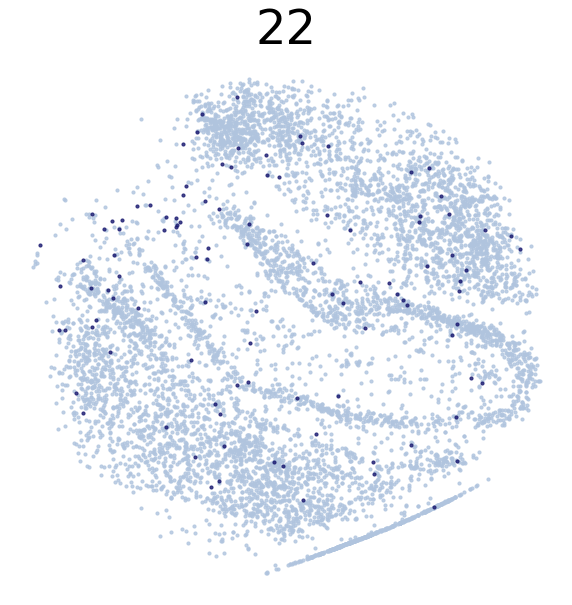

HC2:


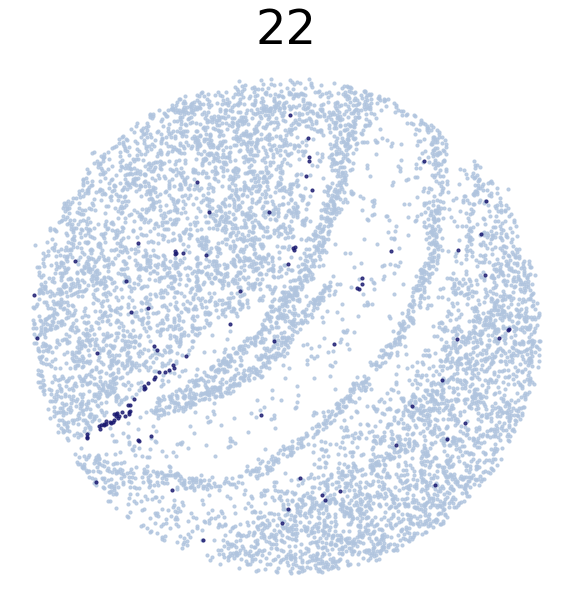

****************
25
****************
Transfer:


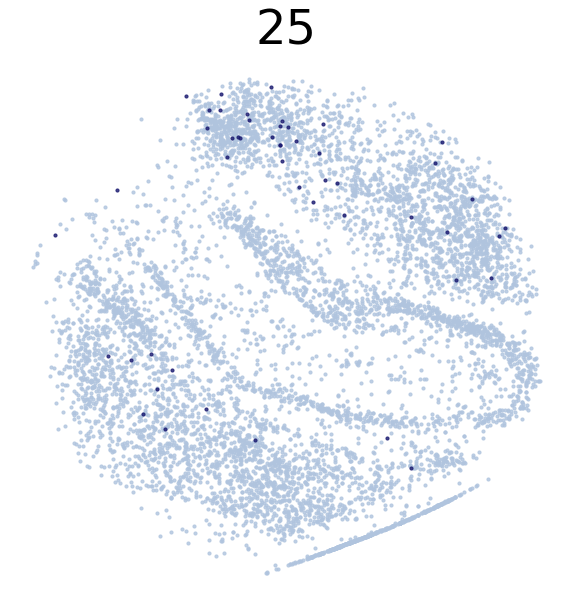

HC2:


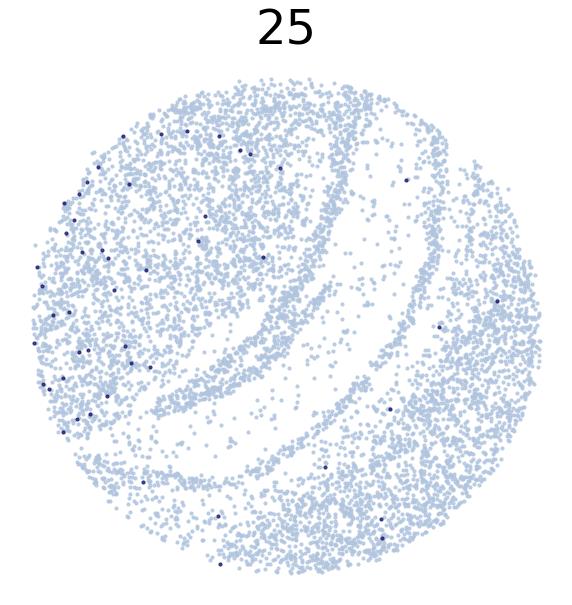

****************
2
****************
Transfer:


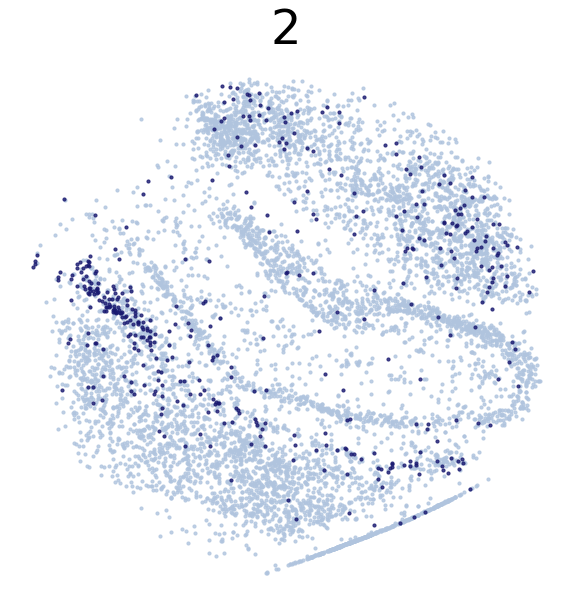

HC2:


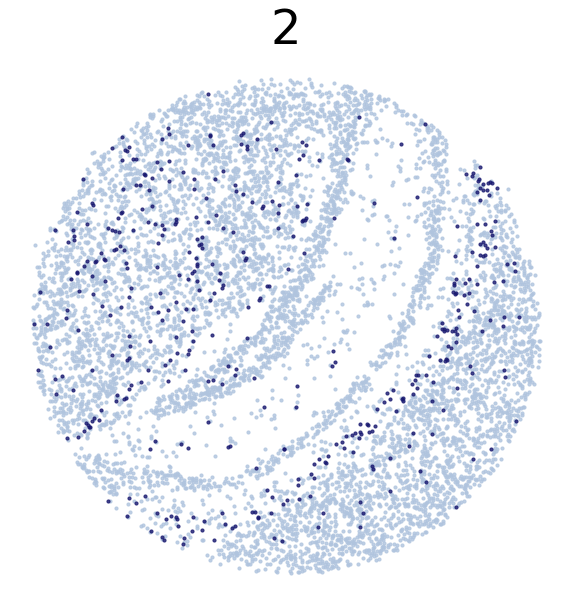

****************
26
****************
Transfer:


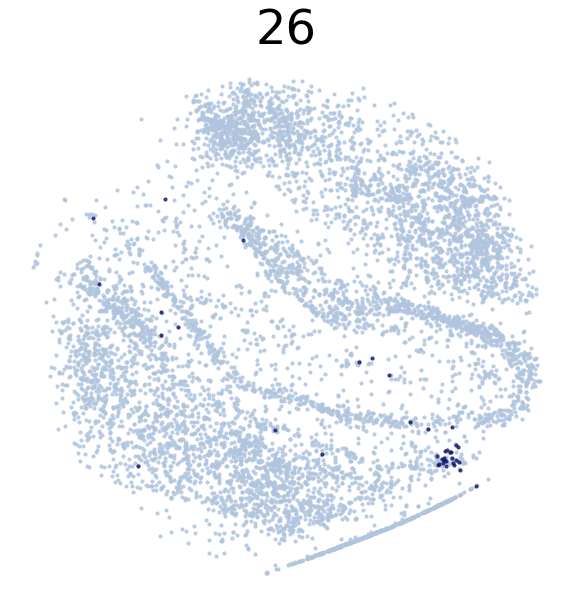

HC2:


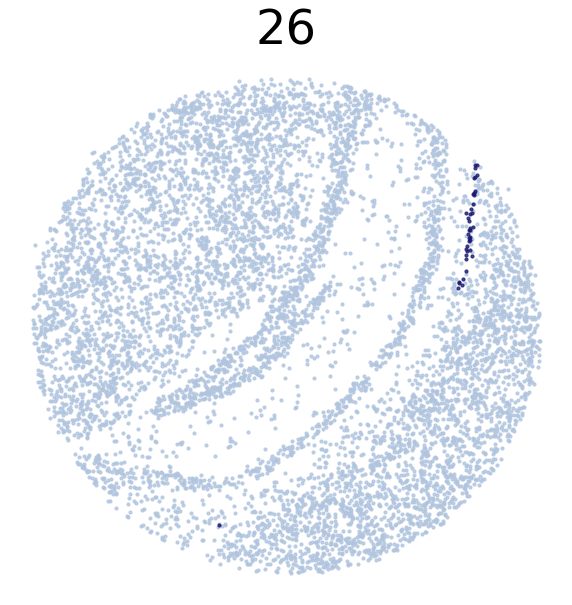

****************
3
****************
Transfer:


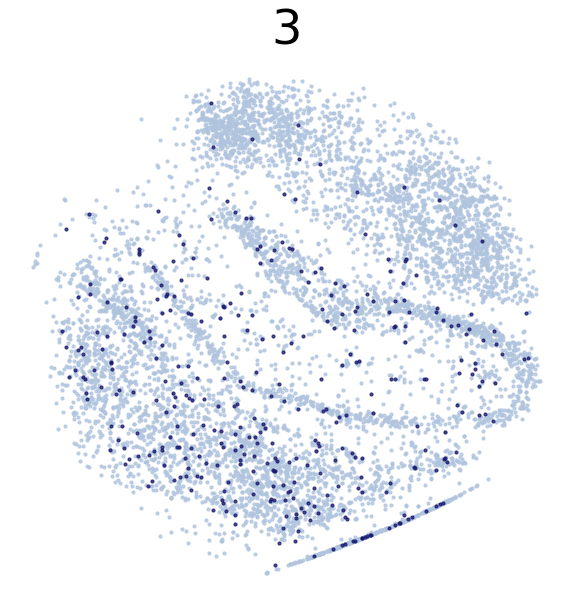

HC2:


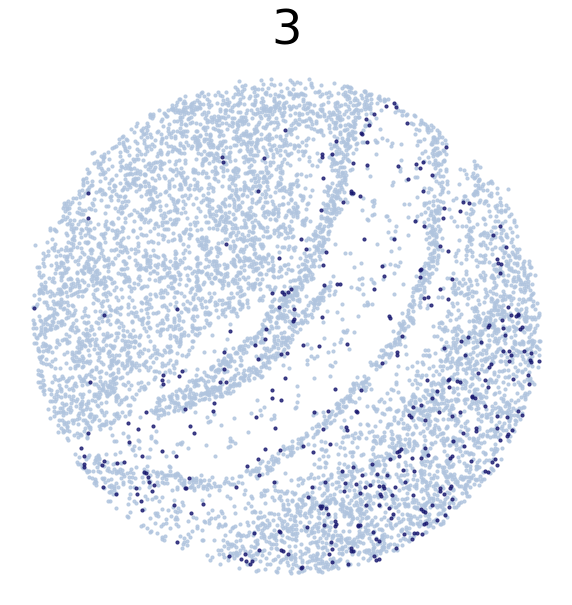

****************
9
****************
Transfer:


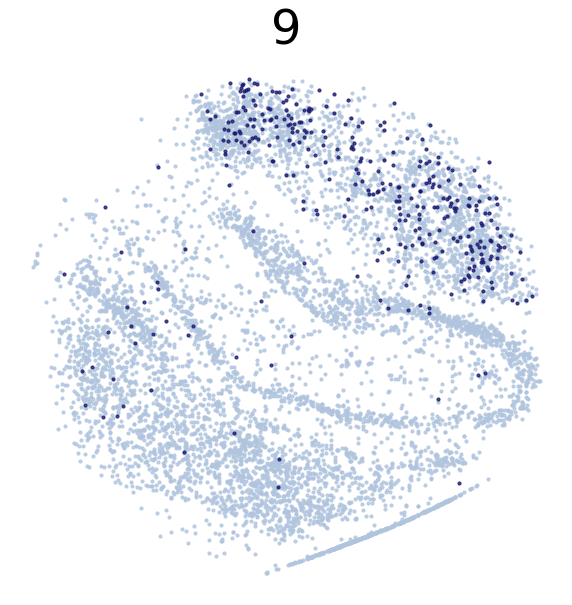

HC2:


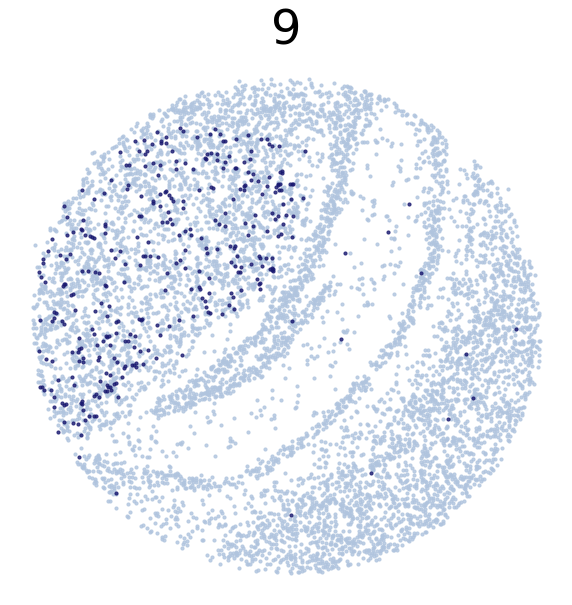

****************
18
****************
Transfer:


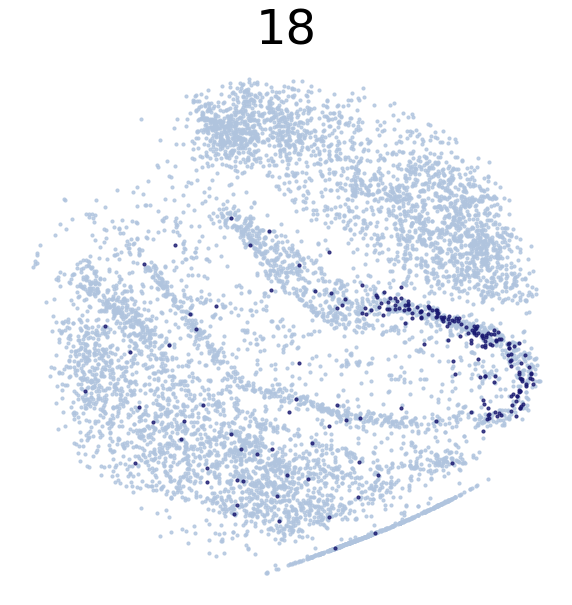

HC2:


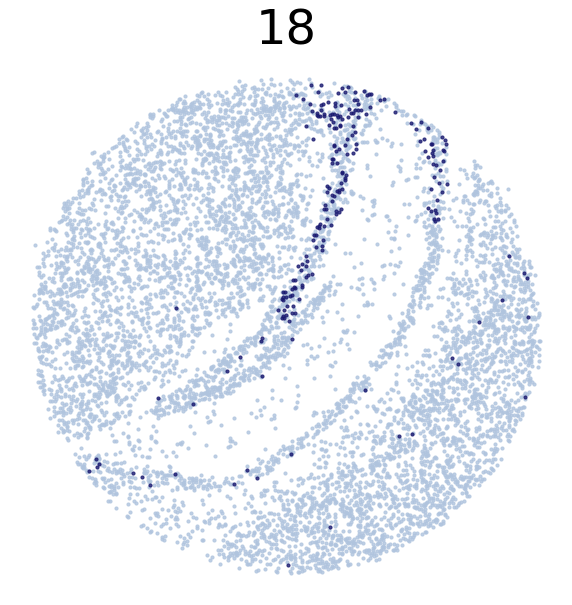

****************
17
****************
Transfer:


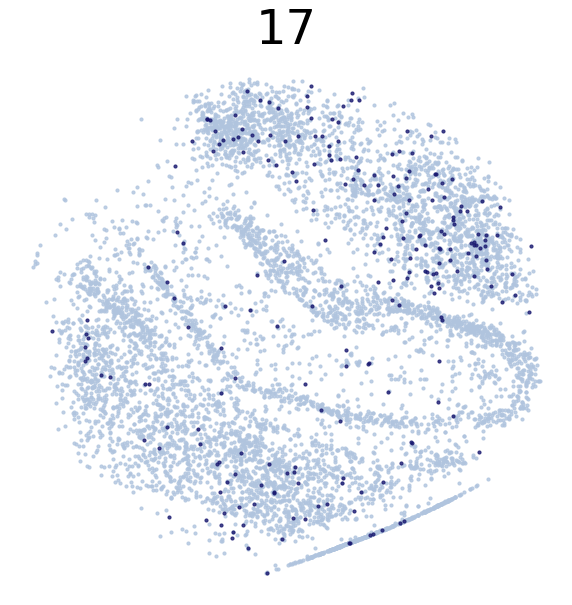

HC2:


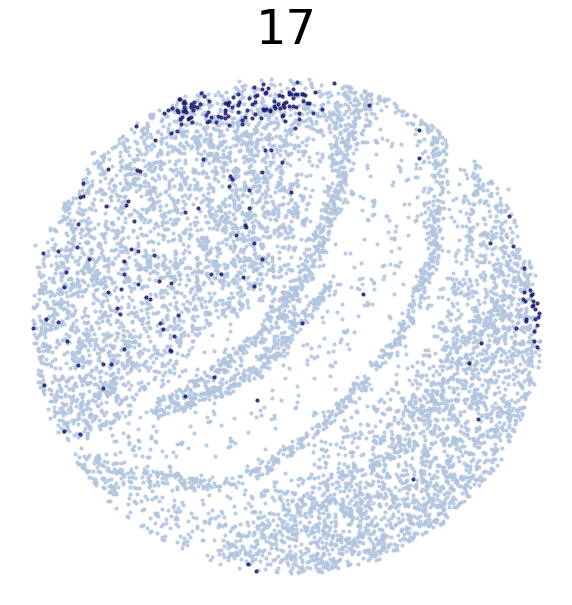

****************
1
****************
Transfer:


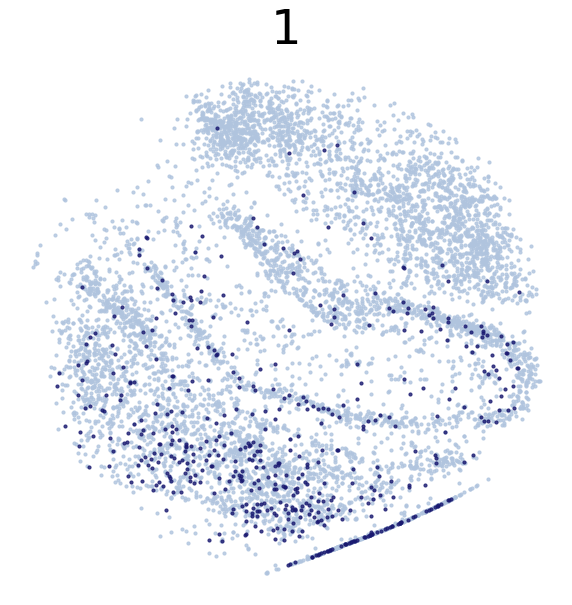

HC2:


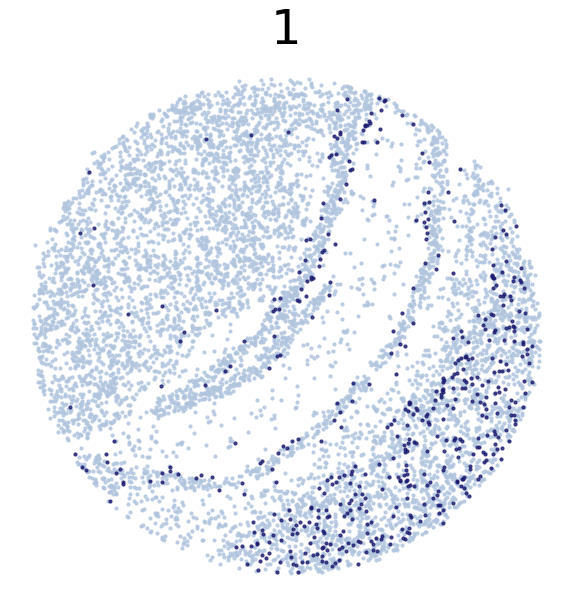

****************
15
****************
Transfer:


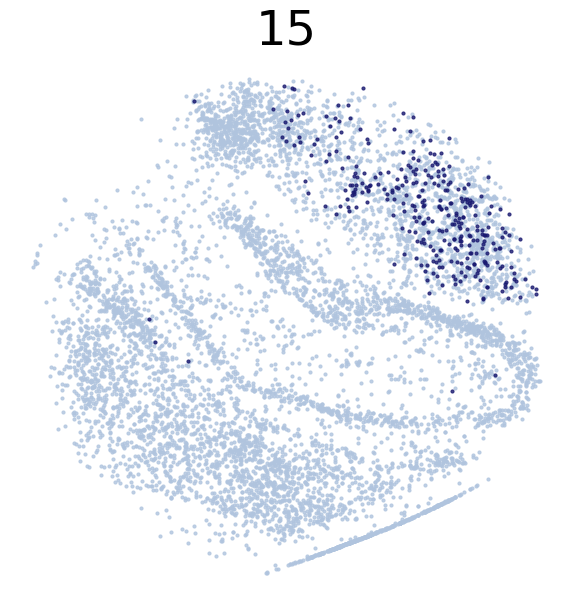

HC2:


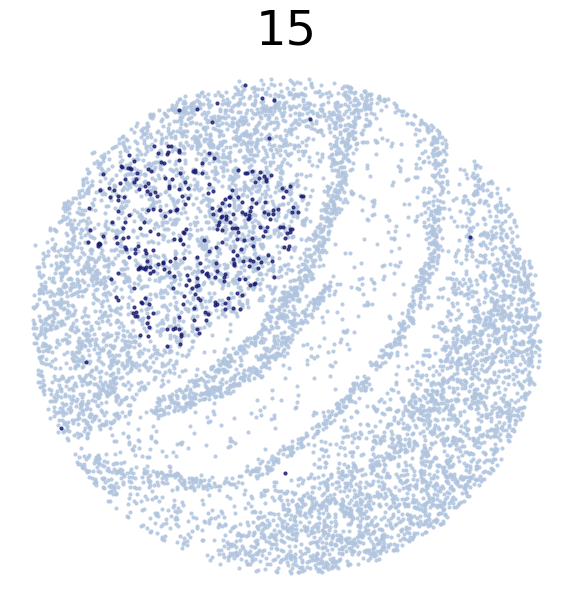

****************
8
****************
Transfer:


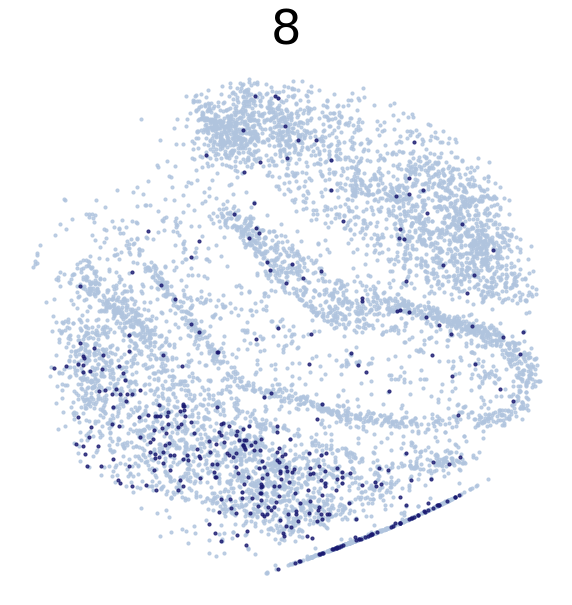

HC2:


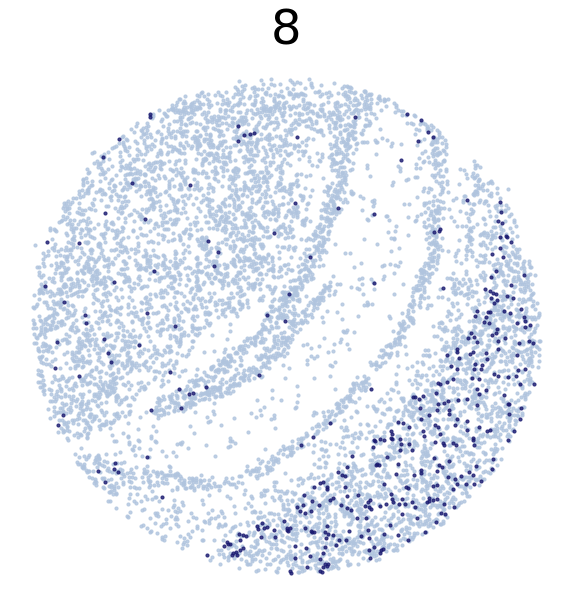

****************
6
****************
Transfer:


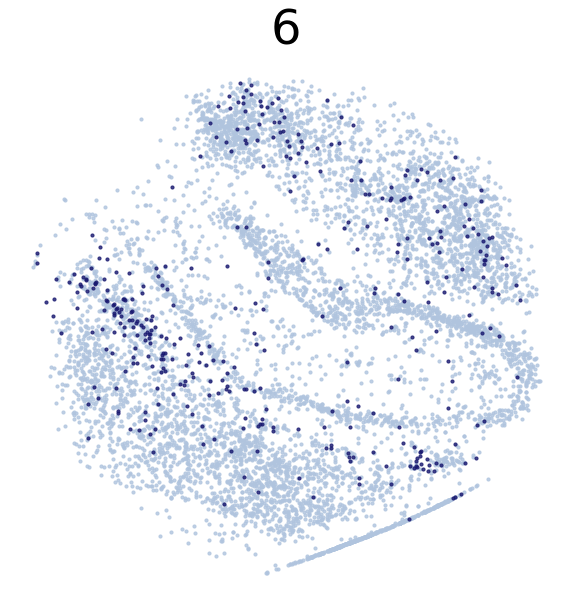

HC2:


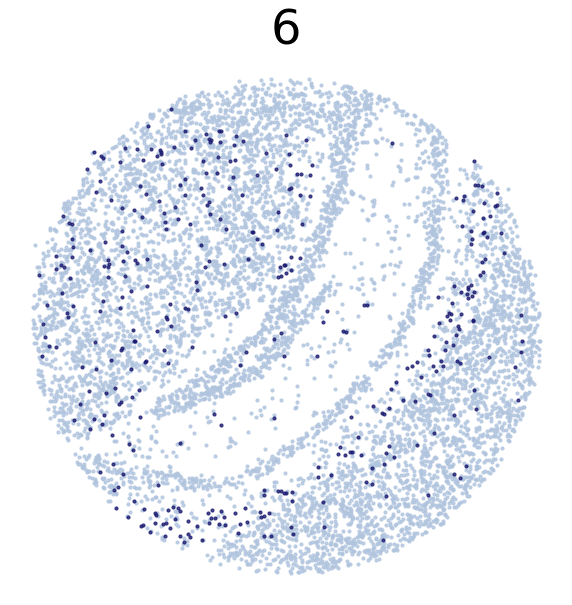

****************
23
****************
Transfer:


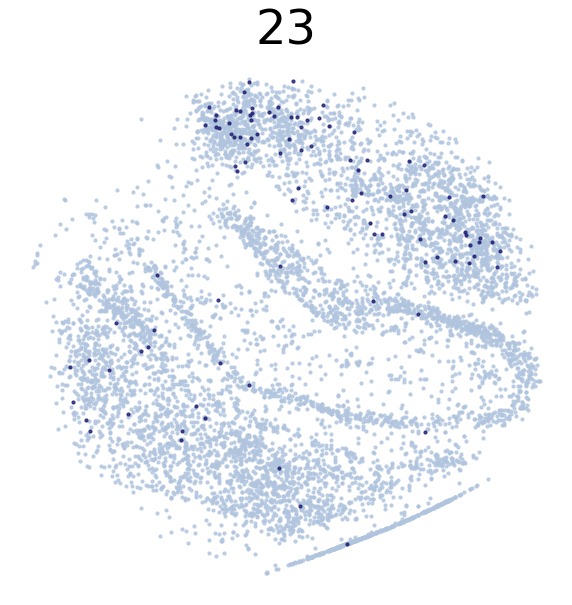

HC2:


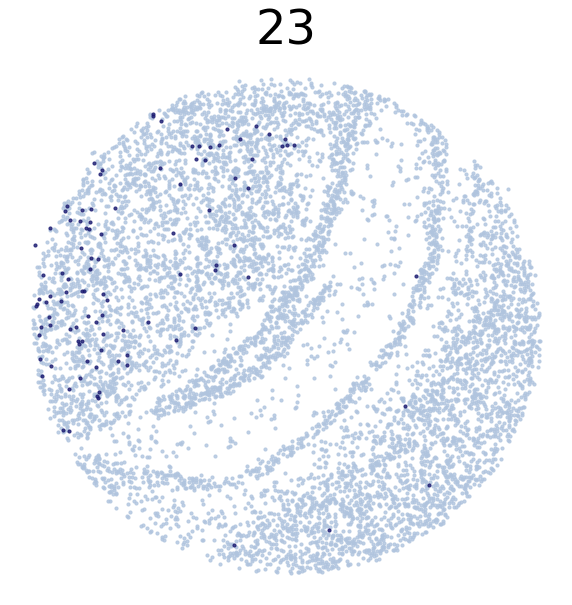

****************
5
****************
Transfer:


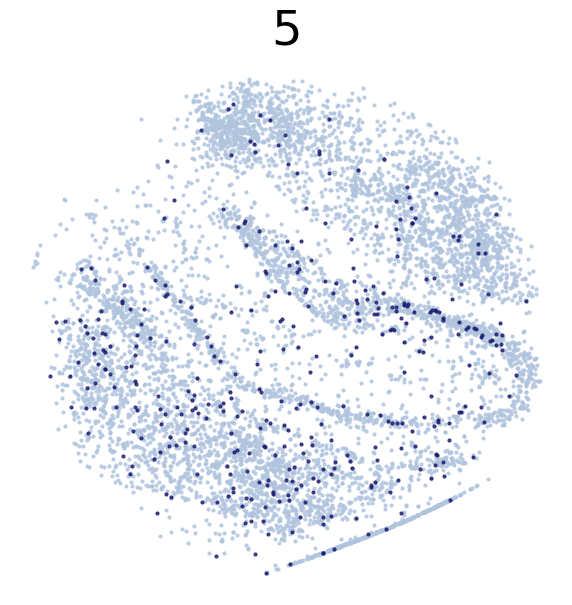

HC2:


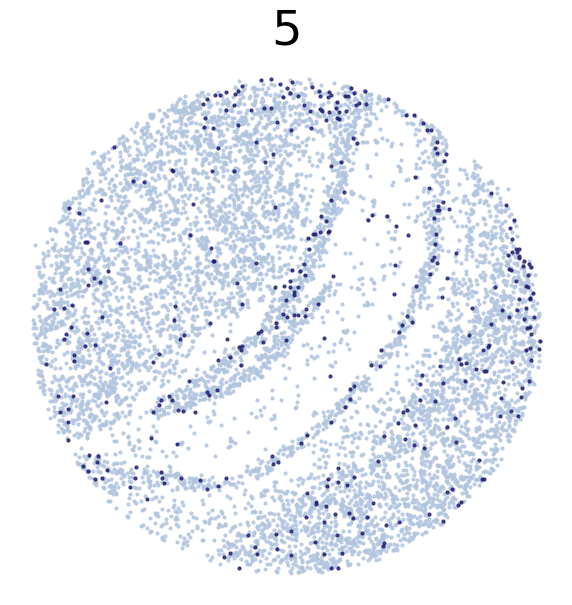

****************
7
****************
Transfer:


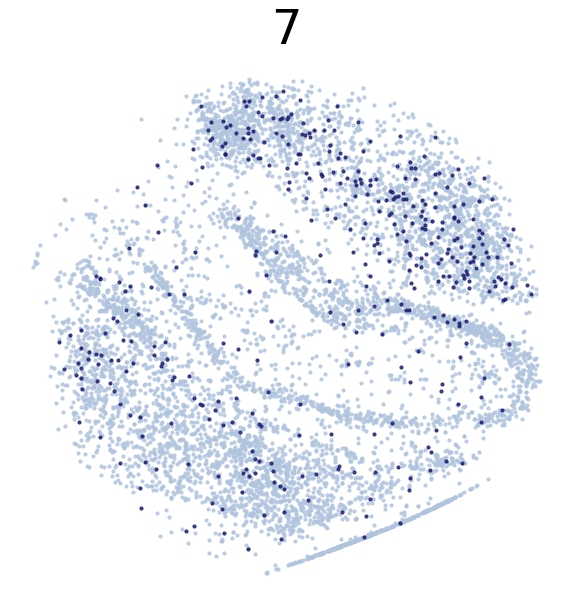

HC2:


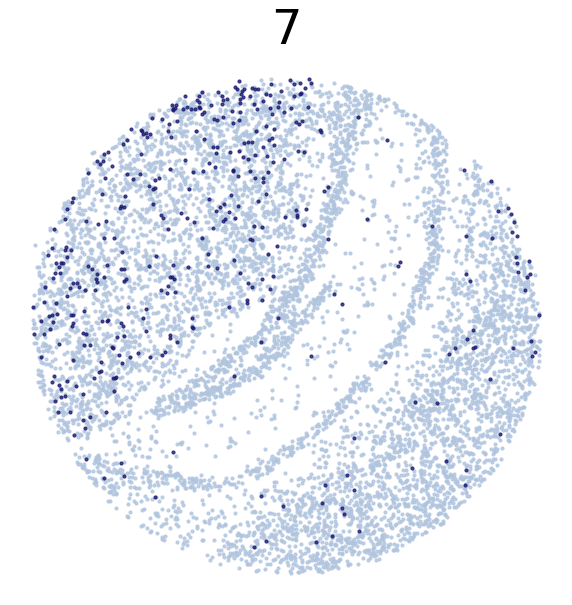

In [4]:
for CT in adata_query.obs['leiden2'].unique():
    print('*'*16)
    print(CT)
    print('*'*16)
    print('Transfer:')
    Vis.DrawCT1(adata_query, coords_name = 'spatial_mapping', CT = CT,
                s = 10, FM = True, c_name = 'leiden2',
                root = 'Transfer1/FM_Valid2/', save = 'HC2toHC1_WD')
    print('HC2:')
    Vis.DrawCT1(adata_query, coords_name = 'spatial',
                CT = CT, s = 10, c_name = 'leiden2',
                root = 'Transfer1/FM_Valid2/', save = 'HC2_WD')

****************
16
****************
Transfer:


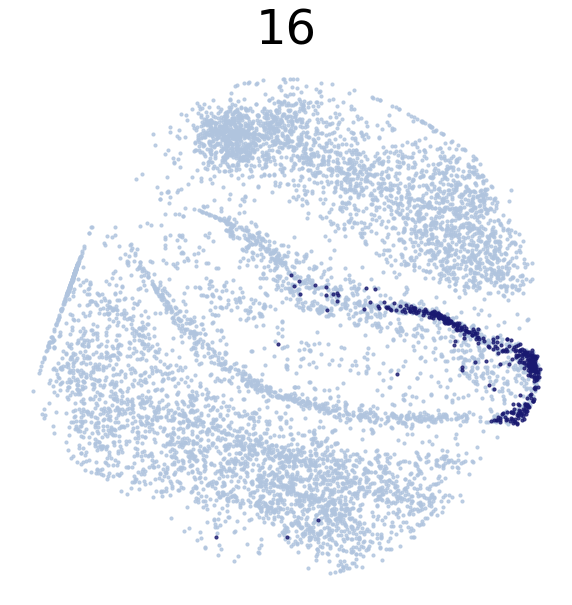

HC2:


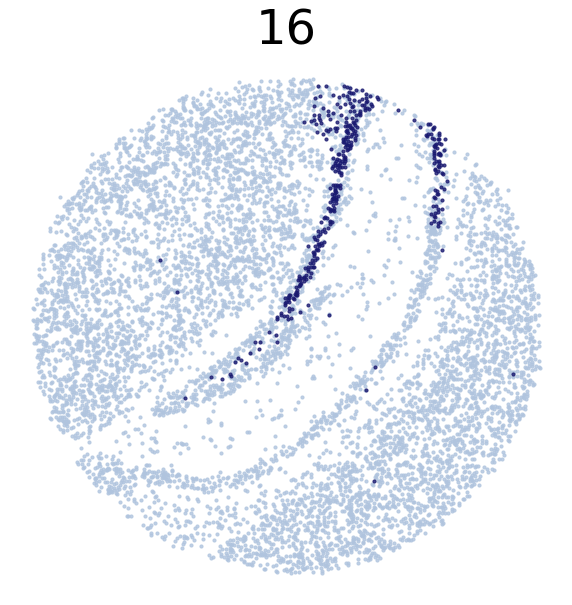

****************
11
****************
Transfer:


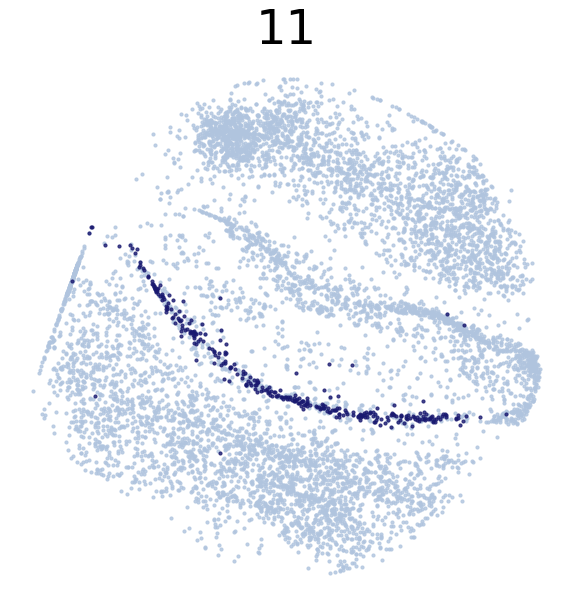

HC2:


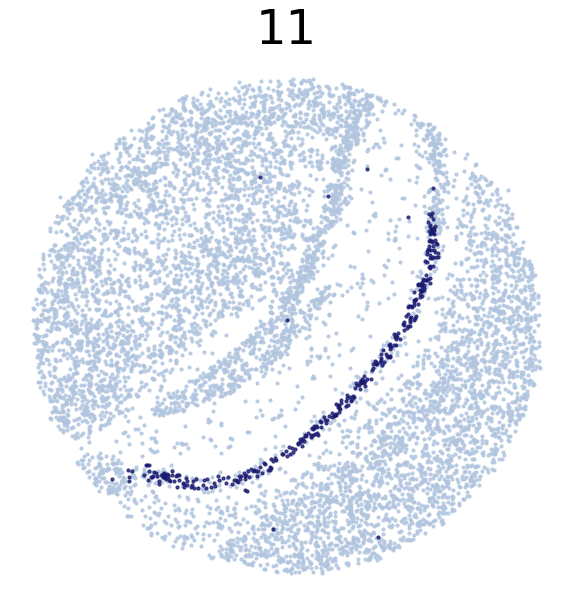

****************
0
****************
Transfer:


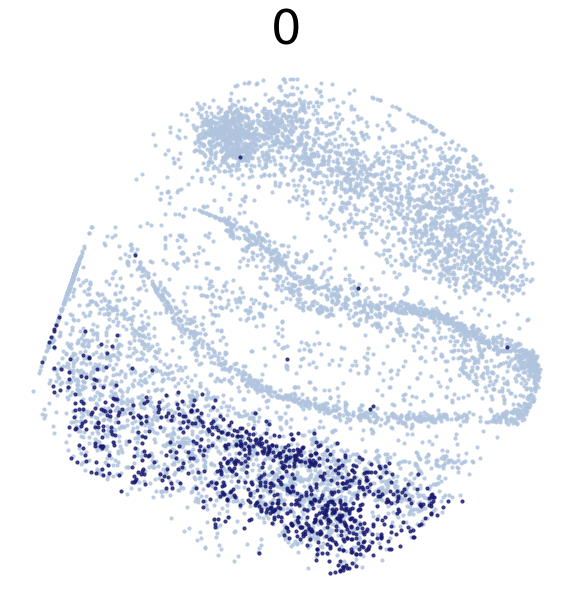

HC2:


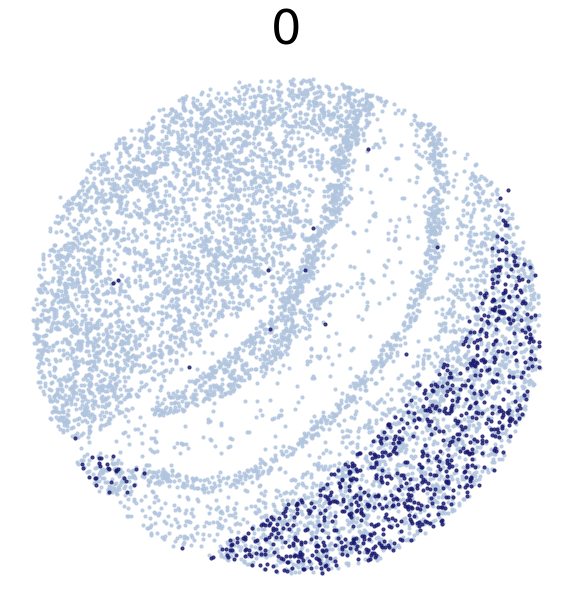

****************
13
****************
Transfer:


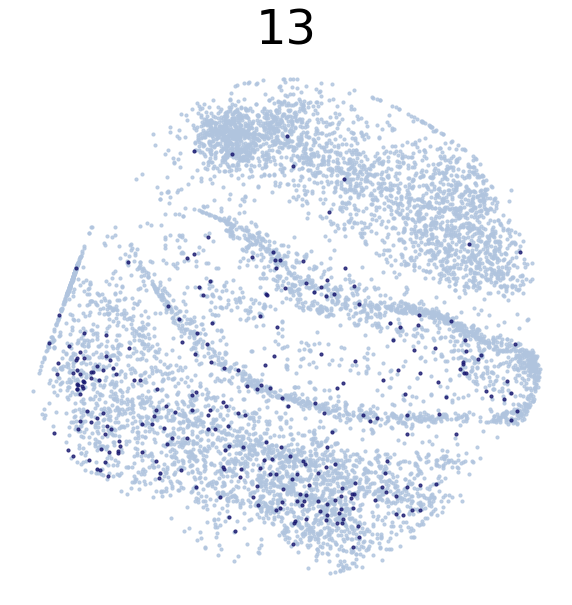

HC2:


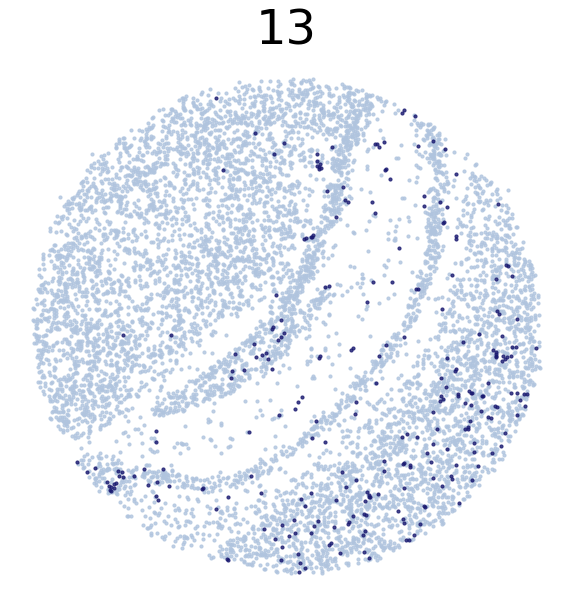

****************
4
****************
Transfer:


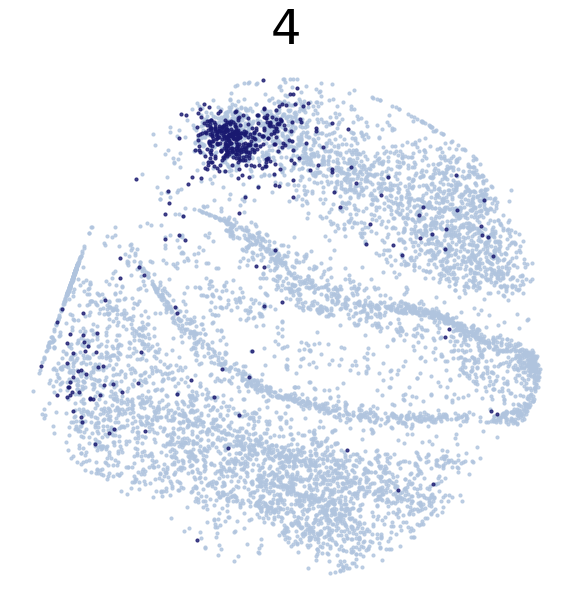

HC2:


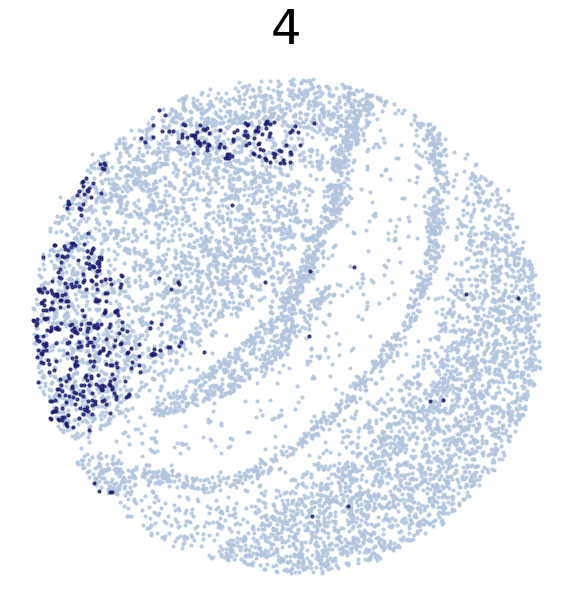

****************
20
****************
Transfer:


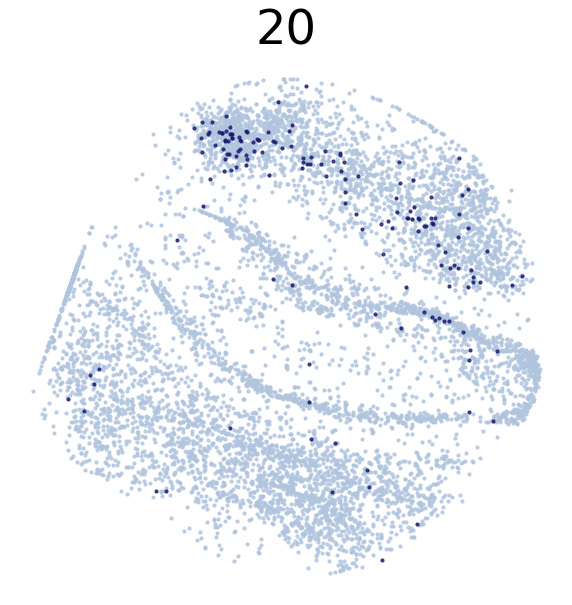

HC2:


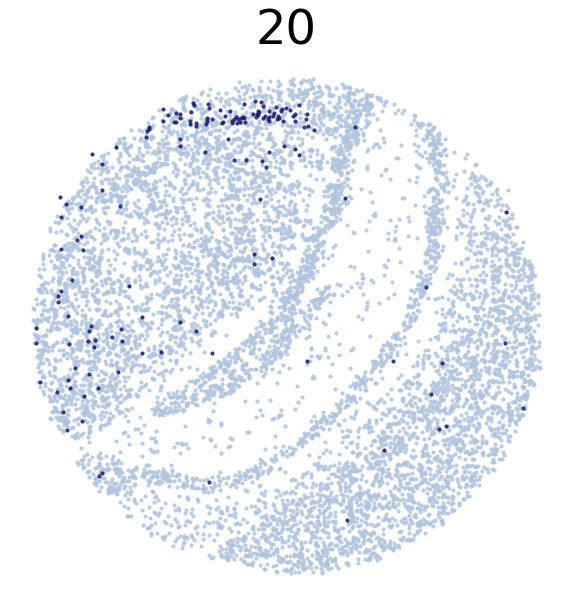

****************
12
****************
Transfer:


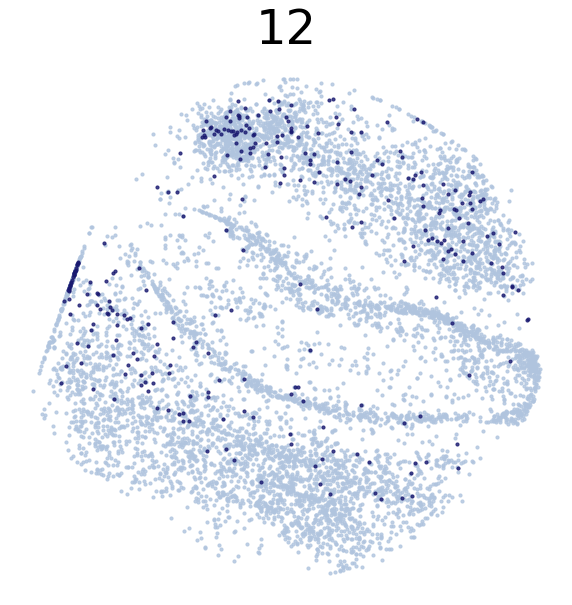

HC2:


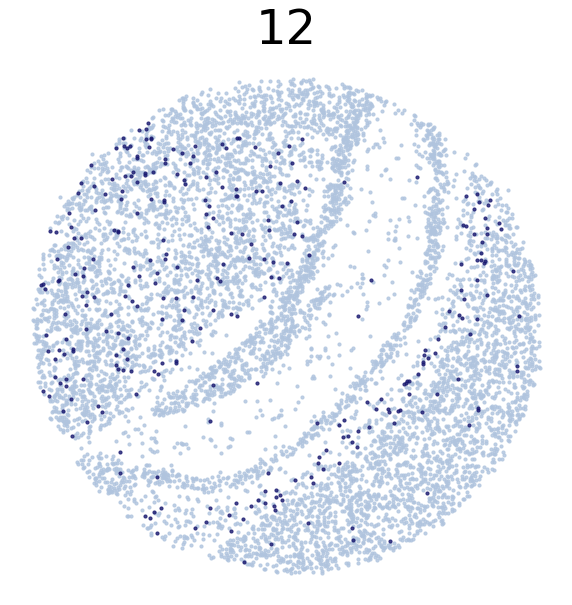

****************
14
****************
Transfer:


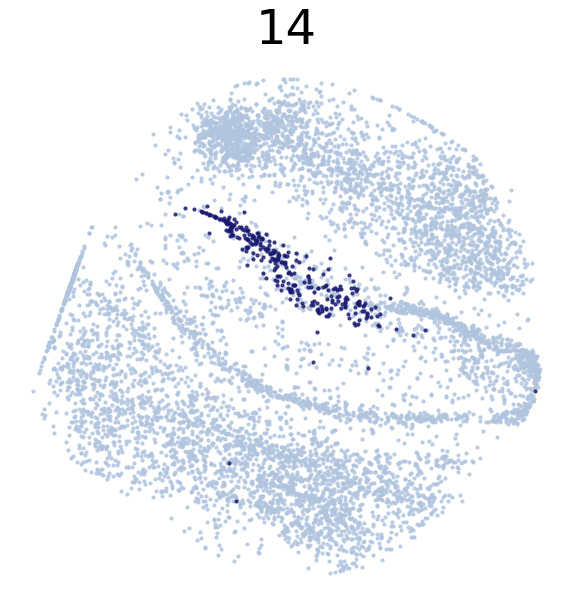

HC2:


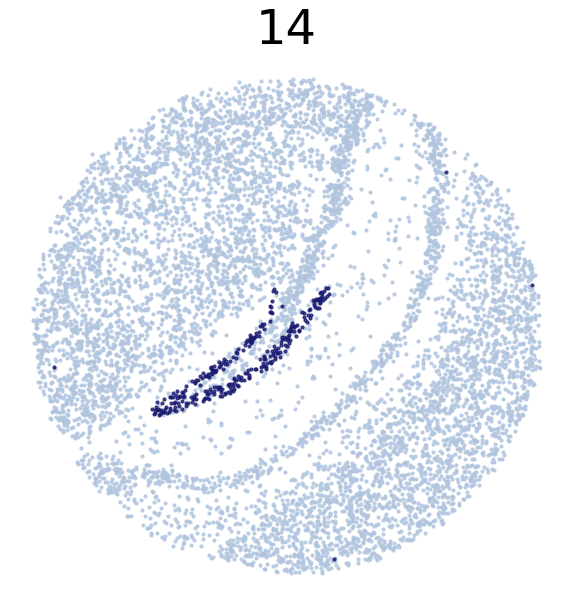

****************
19
****************
Transfer:


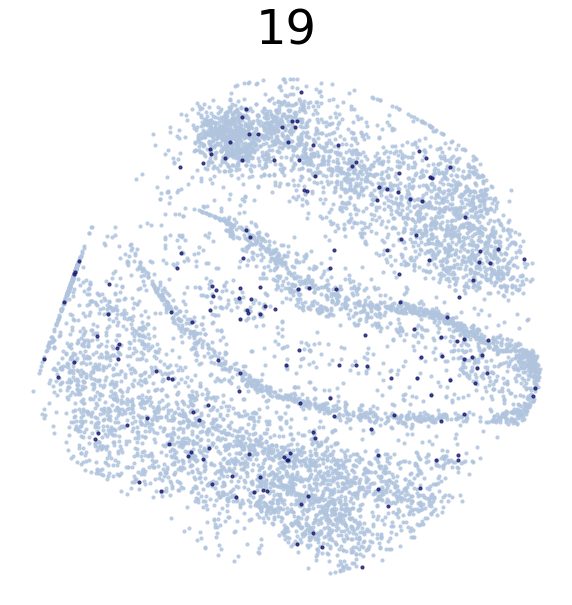

HC2:


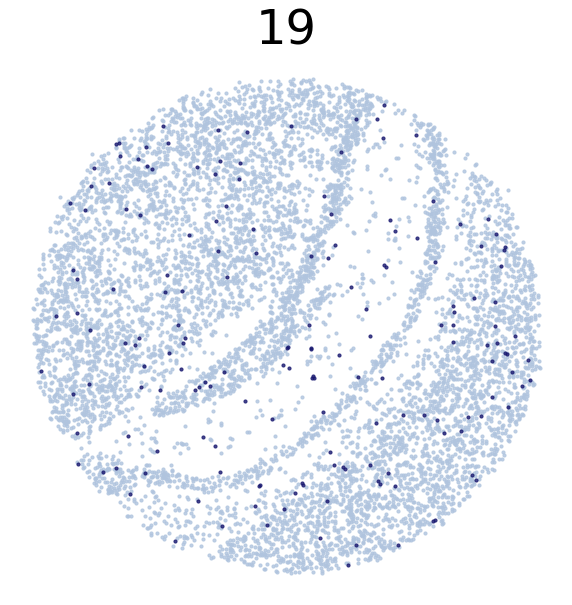

****************
10
****************
Transfer:


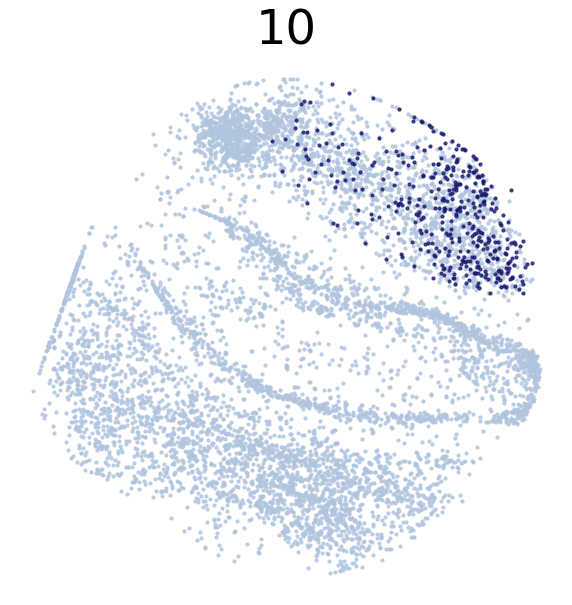

HC2:


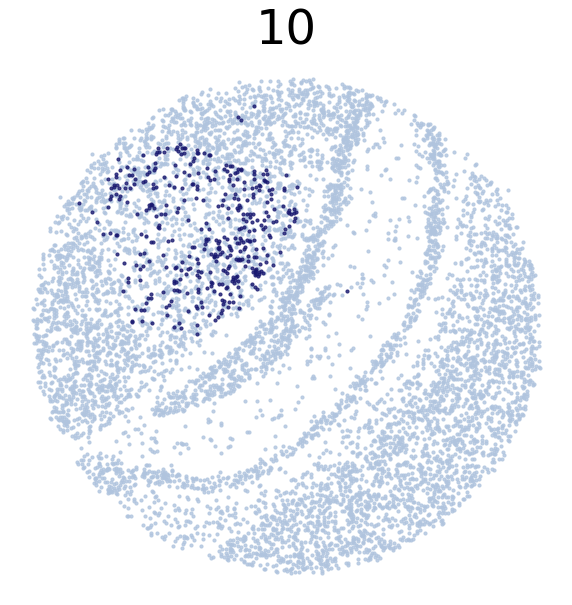

****************
24
****************
Transfer:


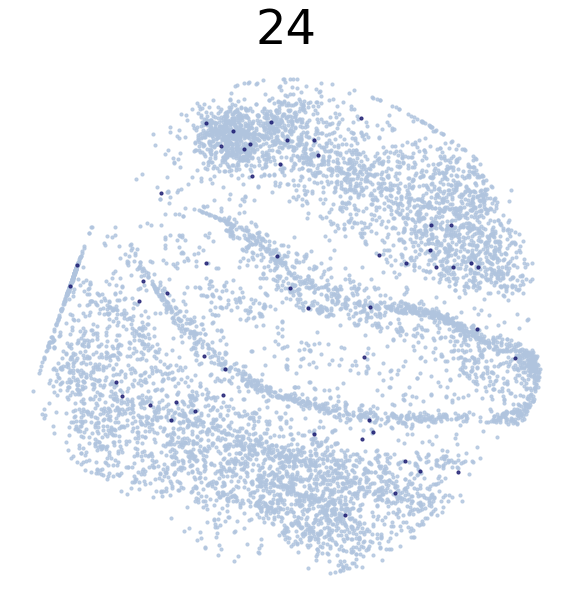

HC2:


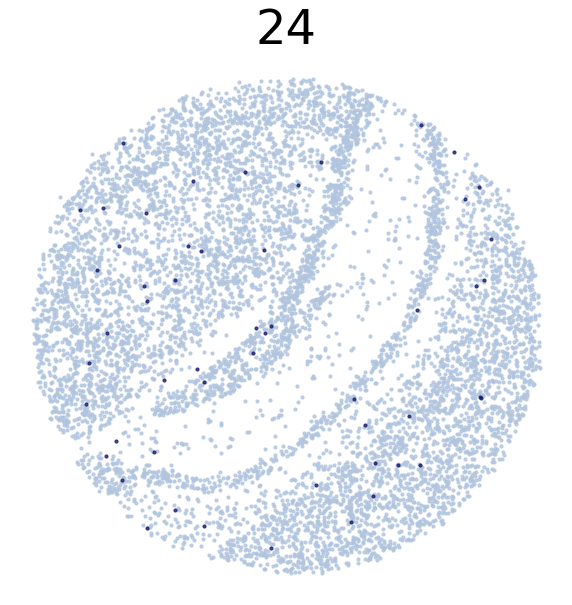

****************
21
****************
Transfer:


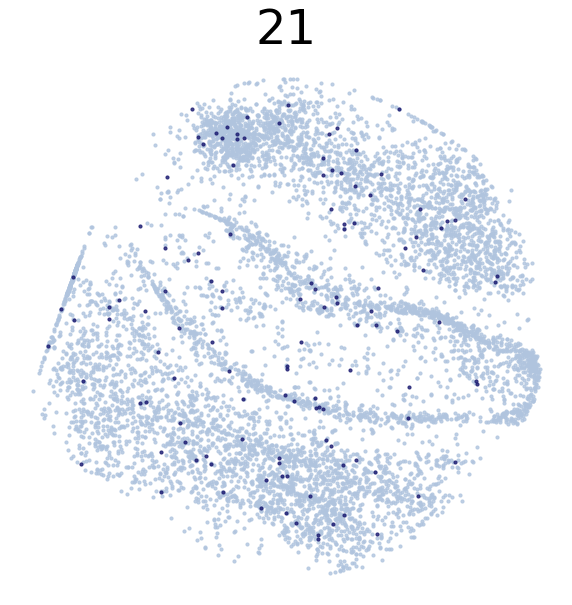

HC2:


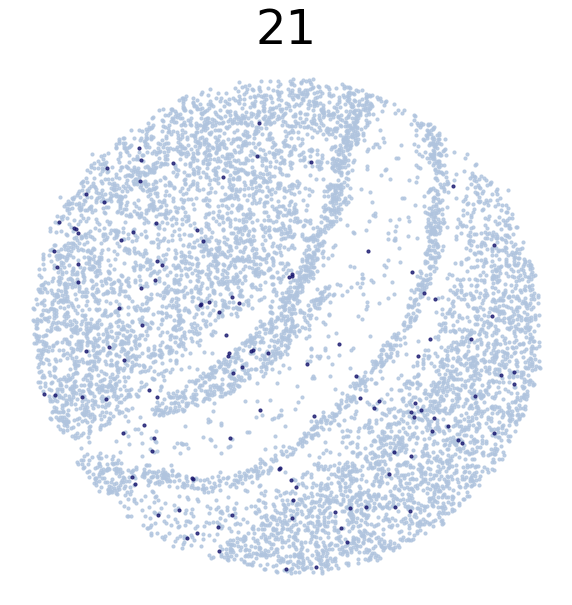

****************
22
****************
Transfer:


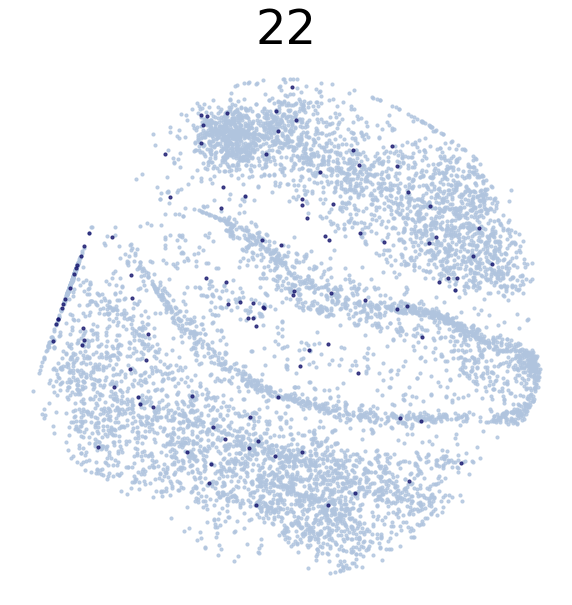

HC2:


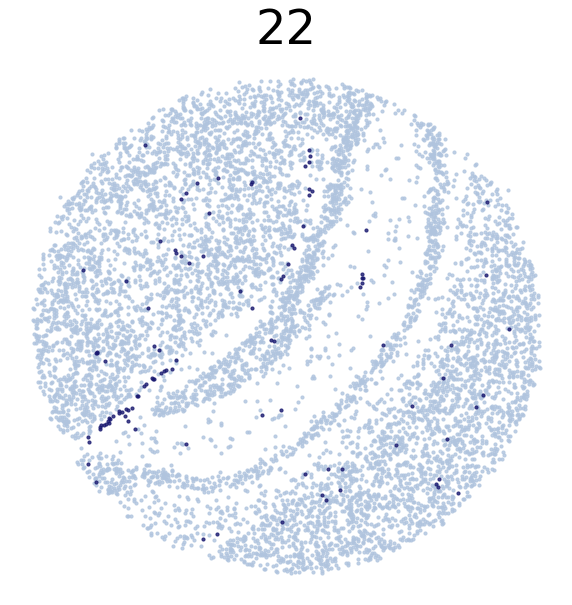

****************
25
****************
Transfer:


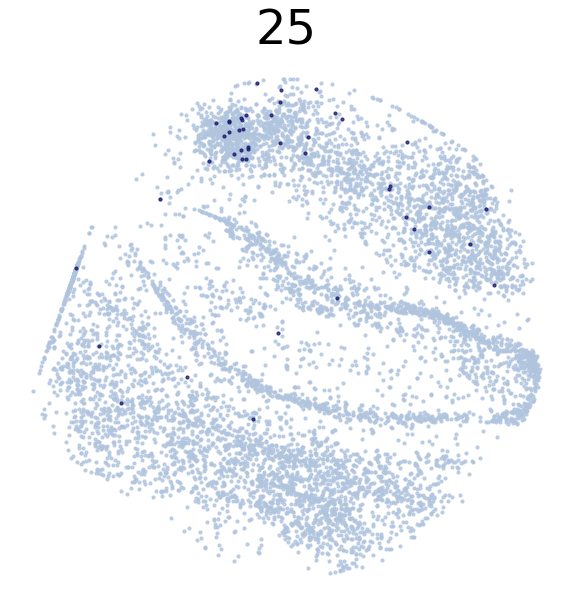

HC2:


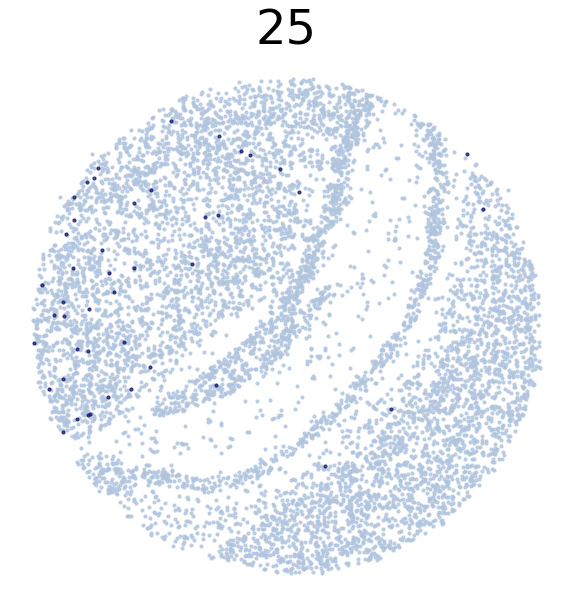

****************
2
****************
Transfer:


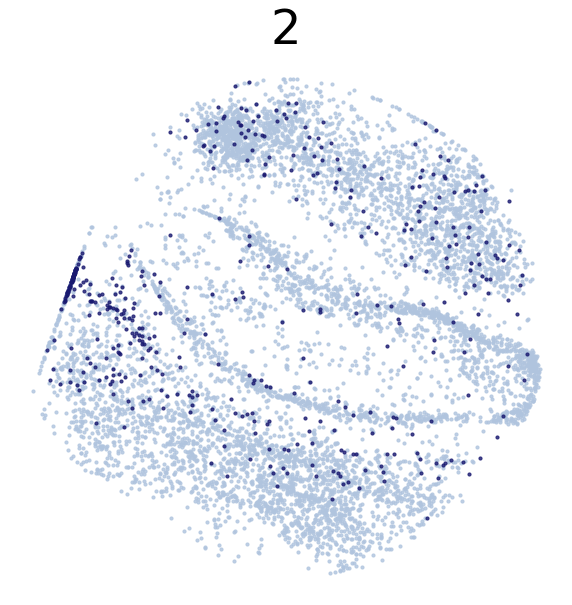

HC2:


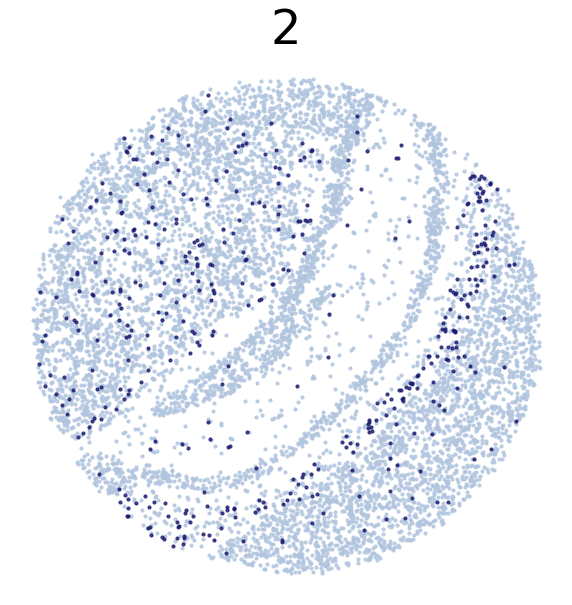

****************
26
****************
Transfer:


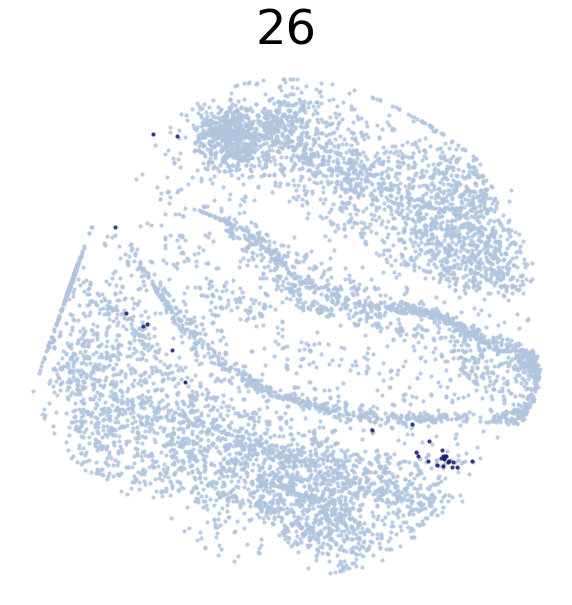

HC2:


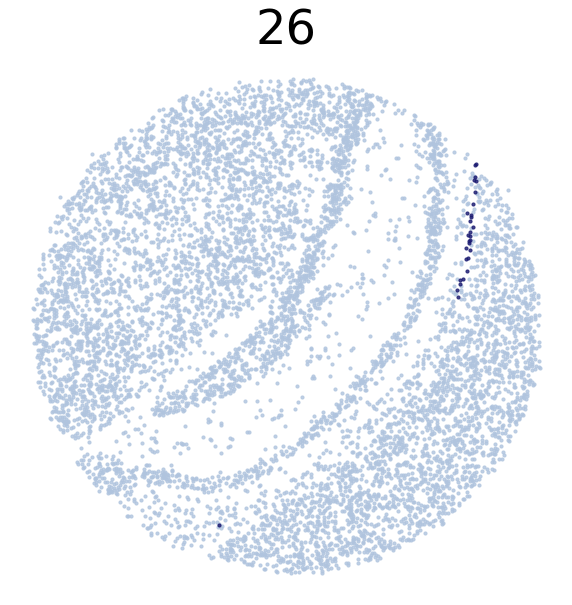

****************
3
****************
Transfer:


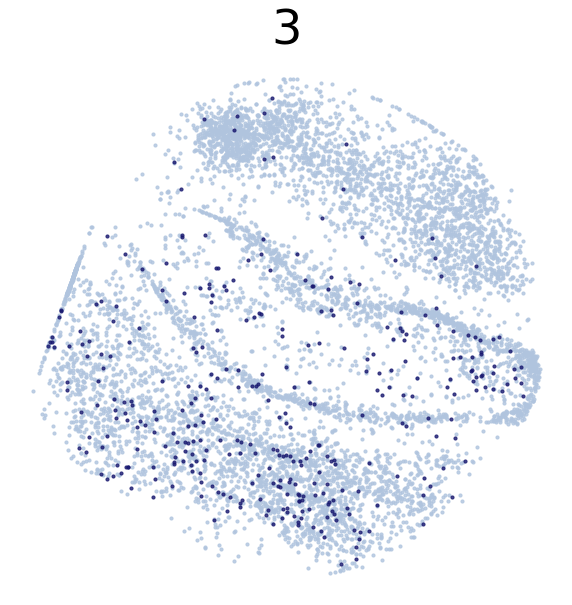

HC2:


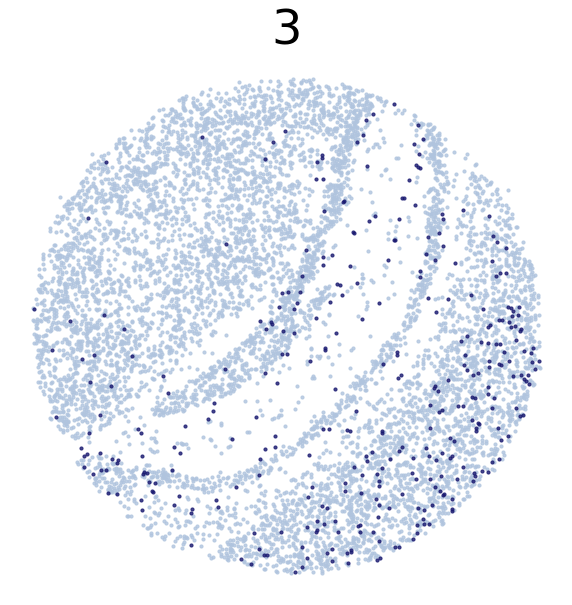

****************
9
****************
Transfer:


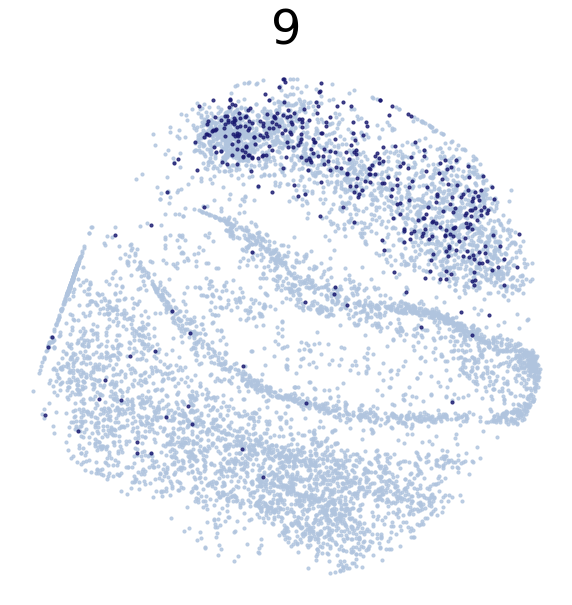

HC2:


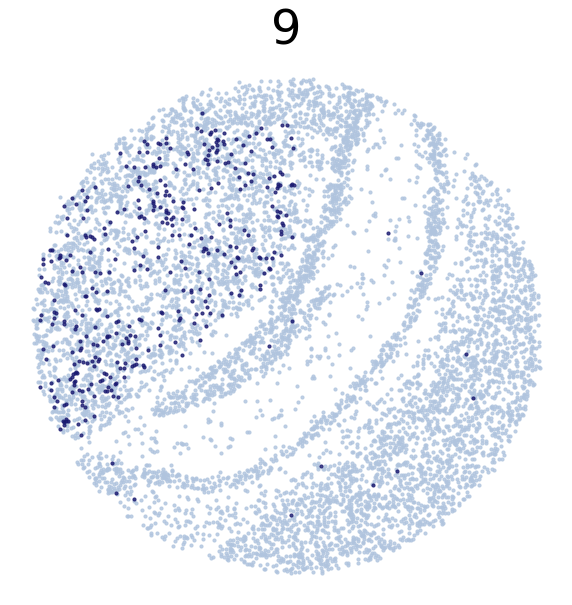

****************
18
****************
Transfer:


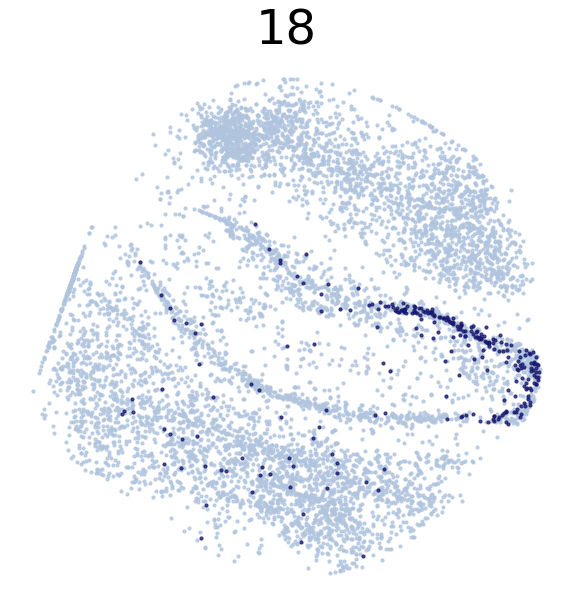

HC2:


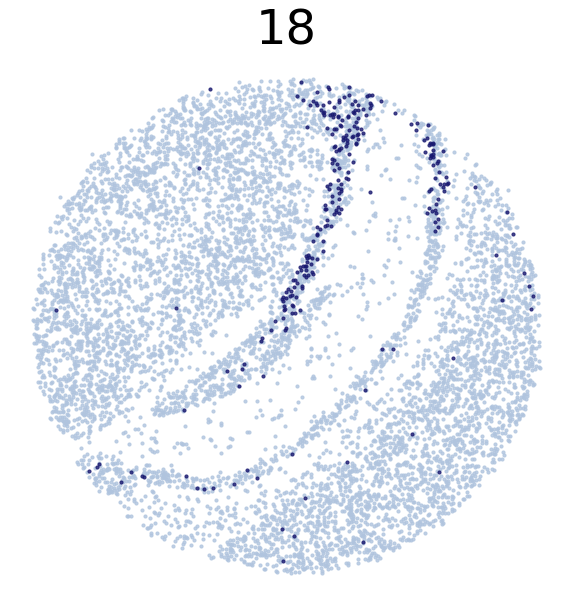

****************
17
****************
Transfer:


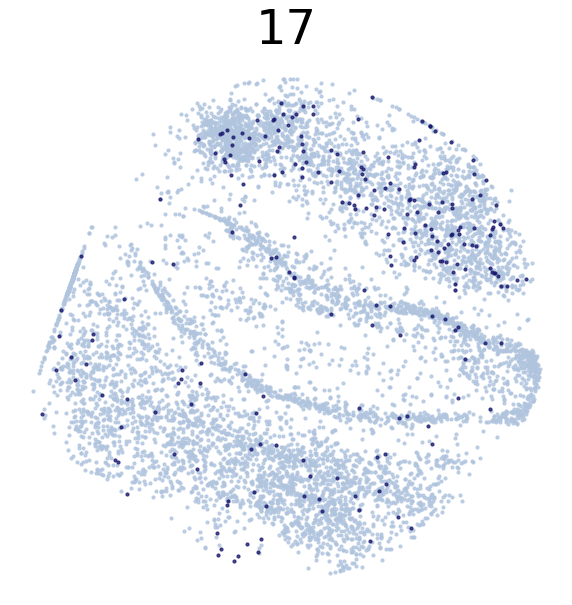

HC2:


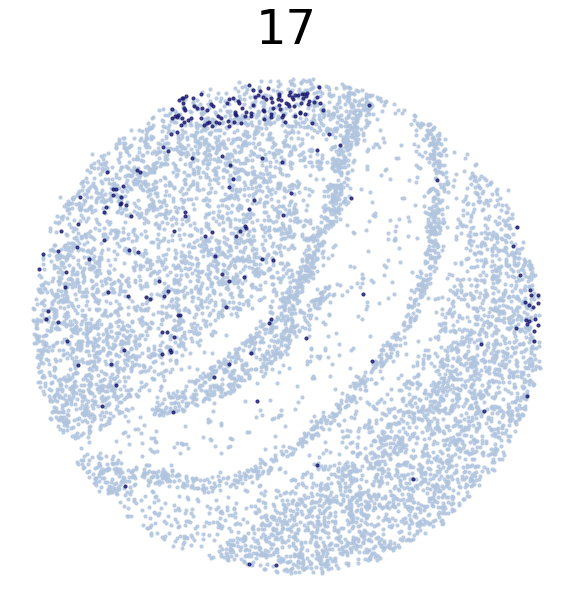

****************
1
****************
Transfer:


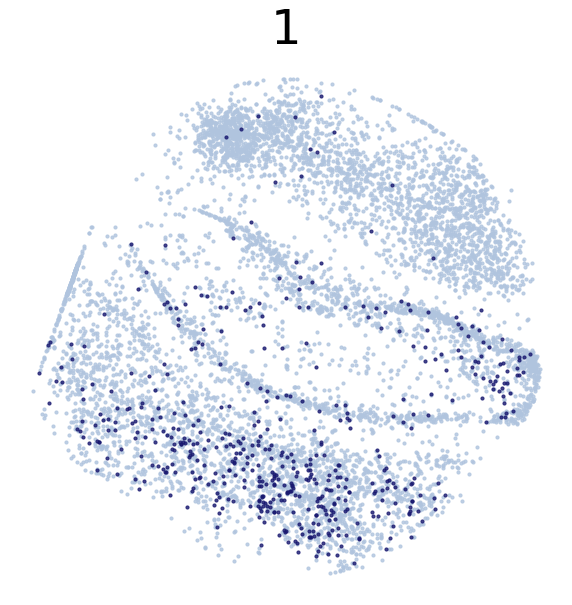

HC2:


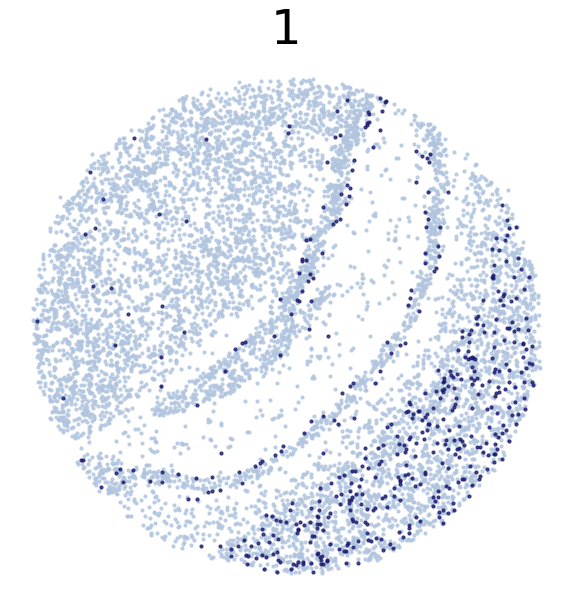

****************
15
****************
Transfer:


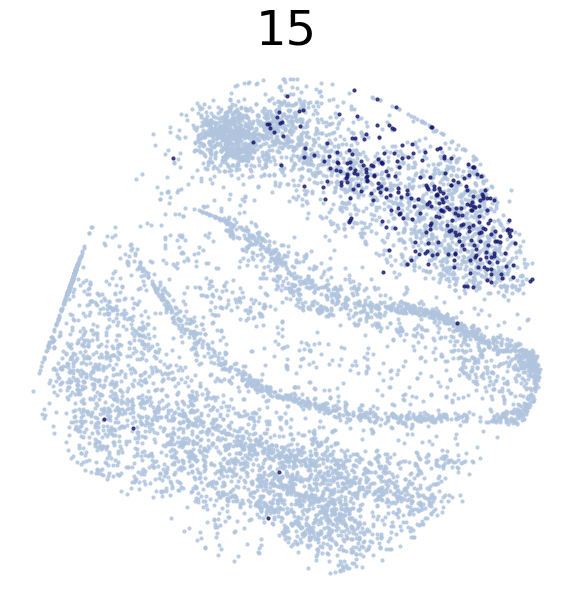

HC2:


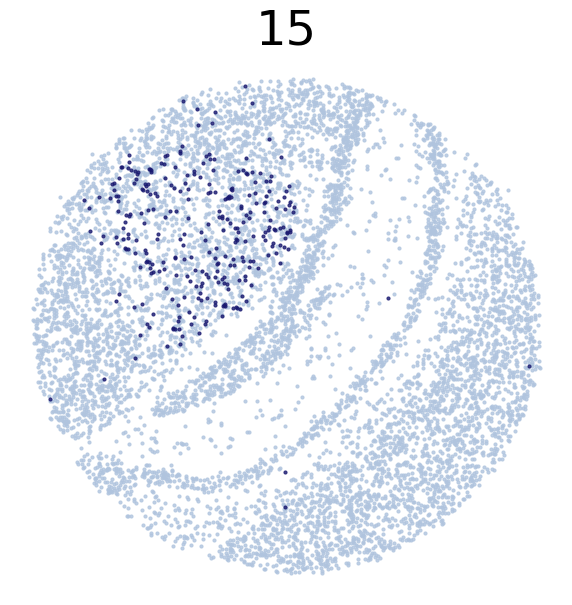

****************
8
****************
Transfer:


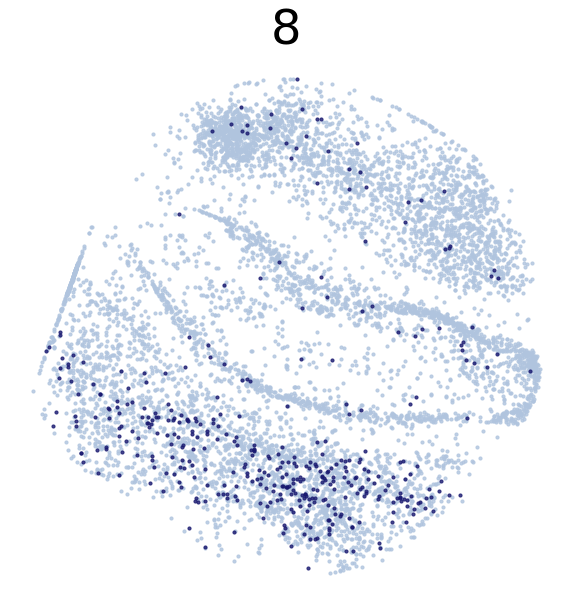

HC2:


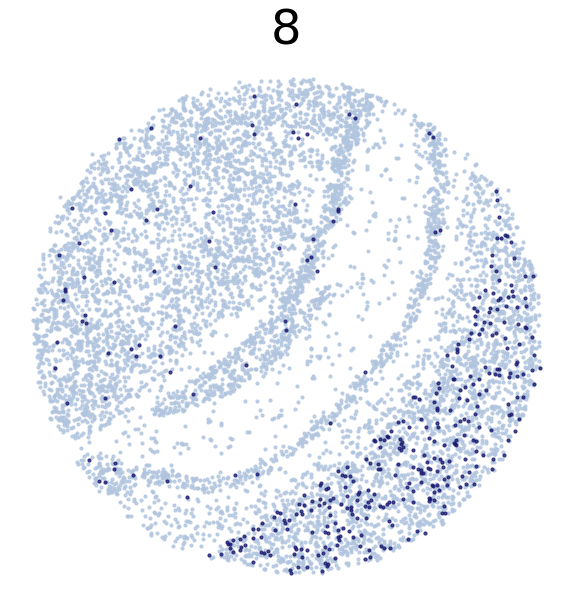

****************
6
****************
Transfer:


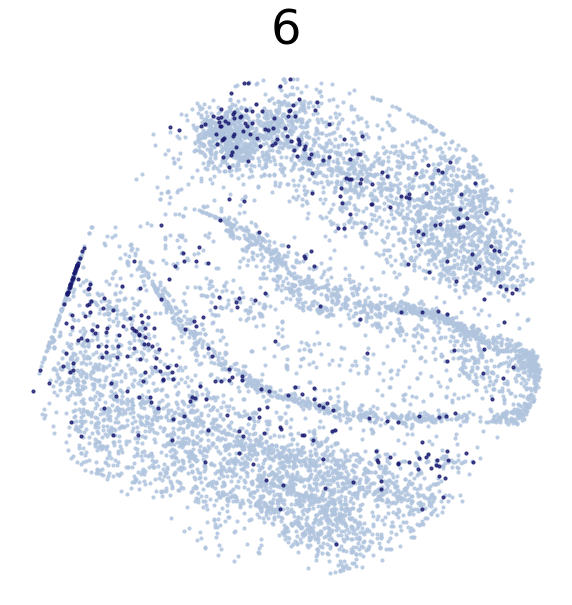

HC2:


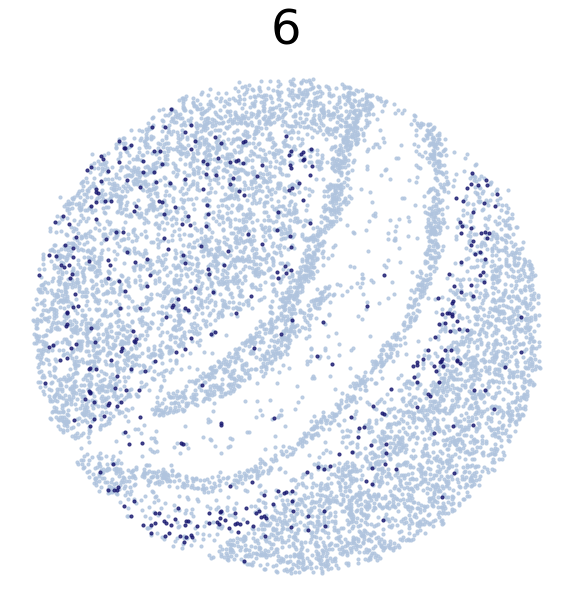

****************
23
****************
Transfer:


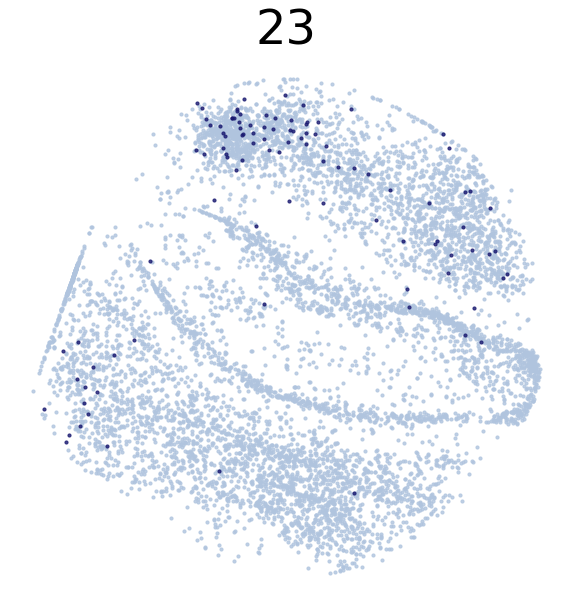

HC2:


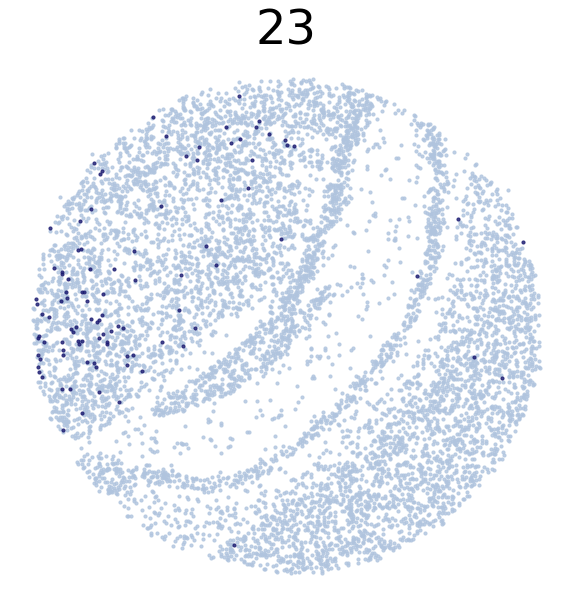

****************
5
****************
Transfer:


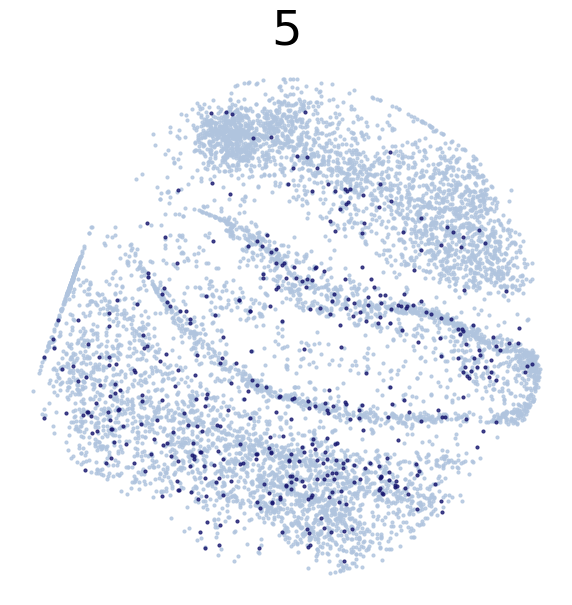

HC2:


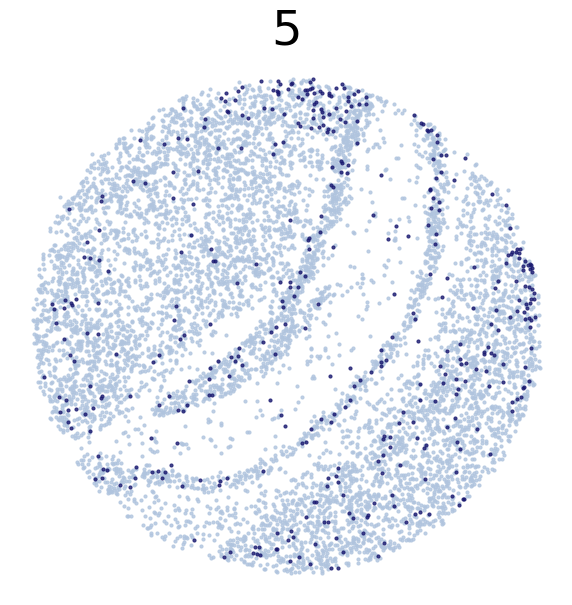

****************
7
****************
Transfer:


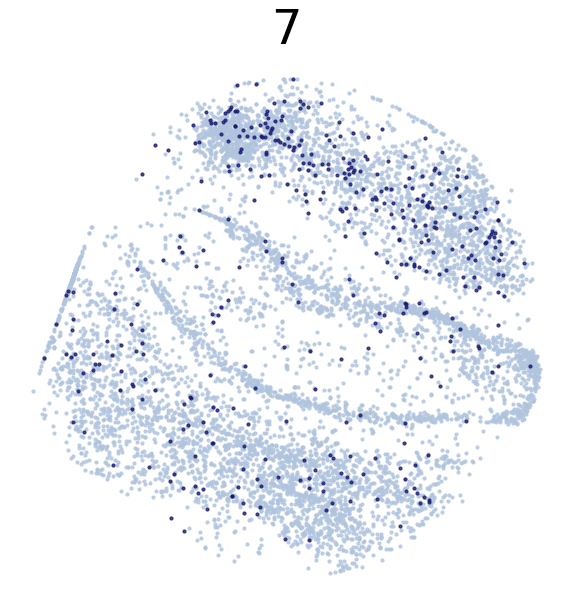

HC2:


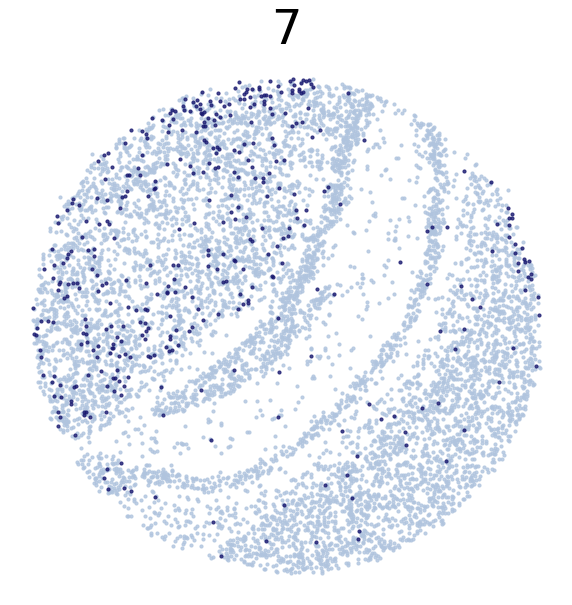

In [48]:
for CT in adata_query.obs['leiden2'].unique():
    print('*'*16)
    print(CT)
    print('*'*16)
    print('Transfer:')
    Vis.DrawCT1(adata_query, coords_name = 'spatial_mapping', CT = CT,
                s = 10, FM = True, c_name = 'leiden2',
                root = 'Transfer1/FM_Valid2/', save = 'HC2toHC1')
    print('HC2:')
    Vis.DrawCT1(adata_query, coords_name = 'spatial',
                CT = CT, s = 10, c_name = 'leiden2',
                root = 'Transfer1/FM_Valid2/', save = 'HC2')

****************
CA3Pc
****************
Transfer:


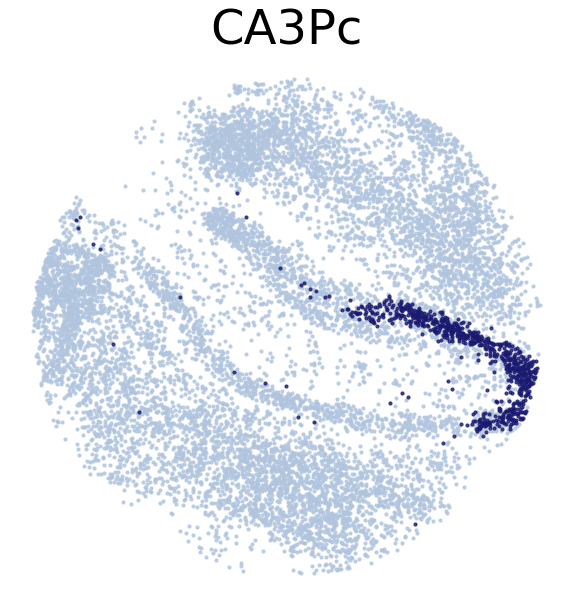

****************
C
****************
Transfer:


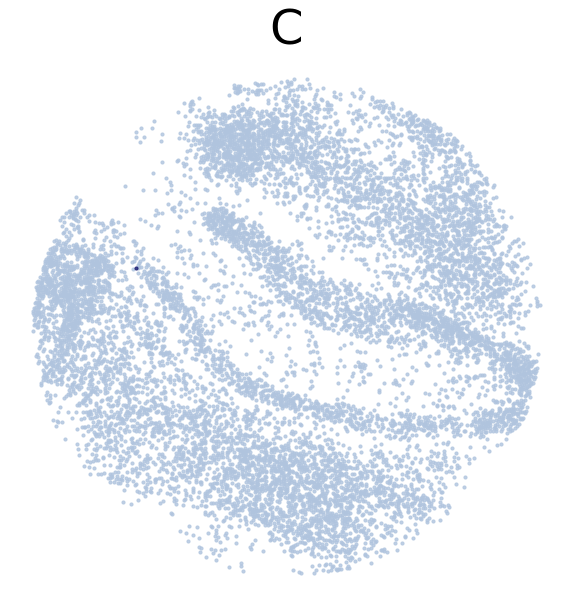

****************
O
****************
Transfer:


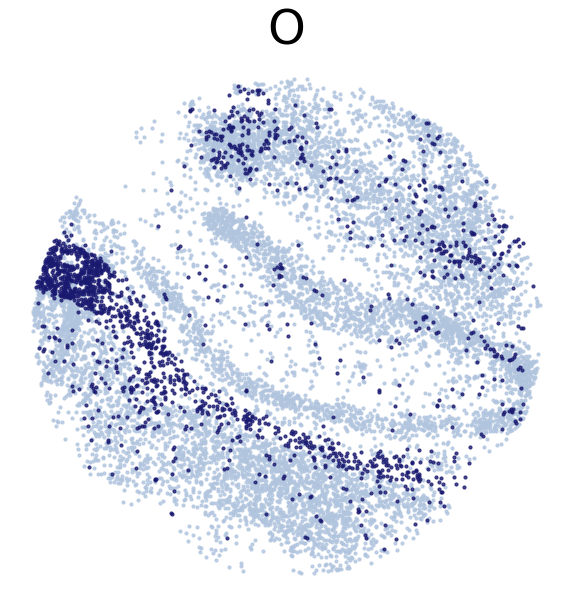

****************
CA1Pc
****************
Transfer:


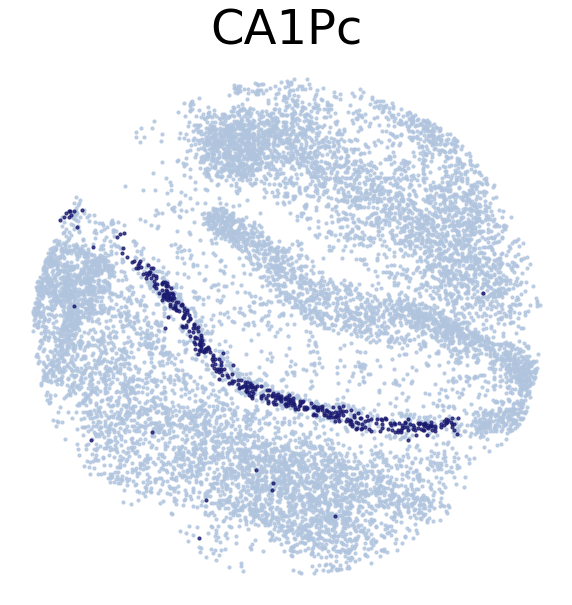

****************
Ec
****************
Transfer:


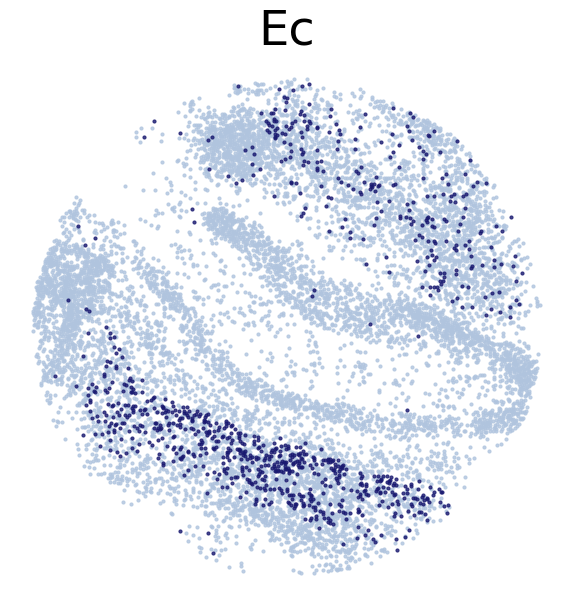

****************
I
****************
Transfer:


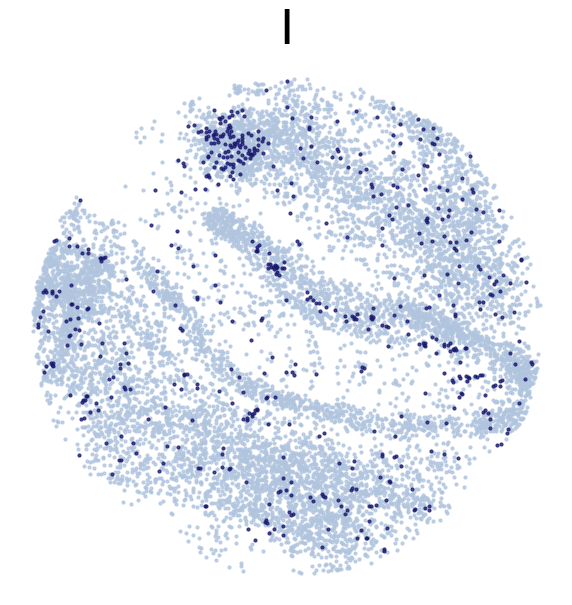

****************
DPc
****************
Transfer:


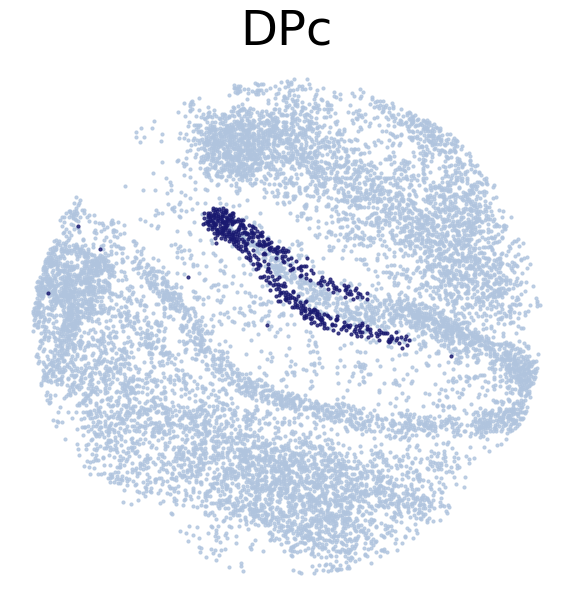

****************
E
****************
Transfer:


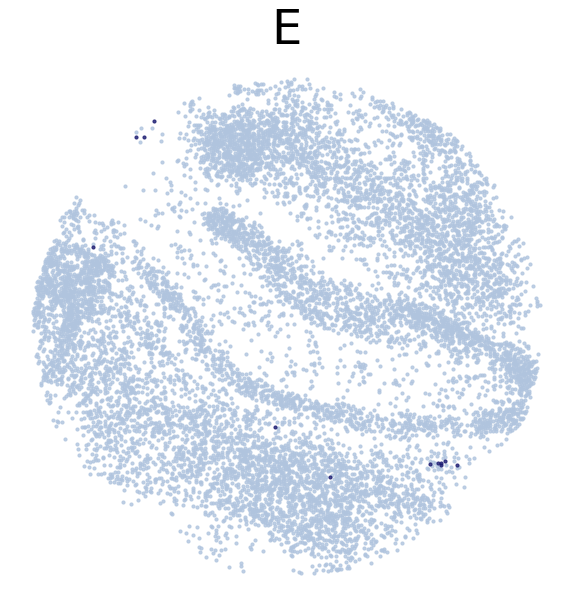

****************
A
****************
Transfer:


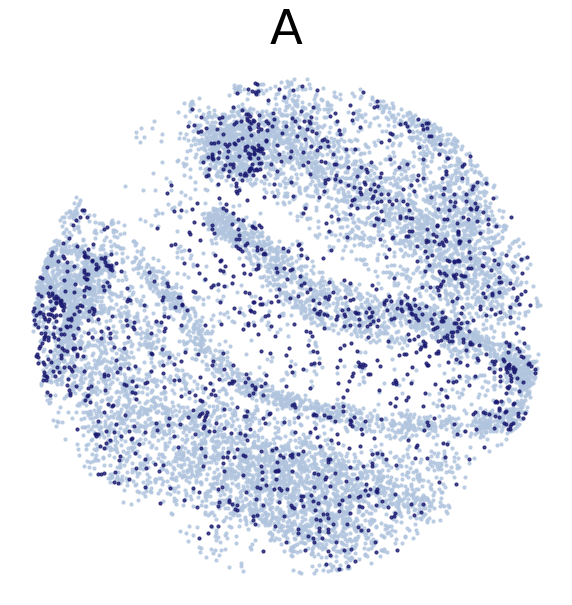

****************
NS
****************
Transfer:


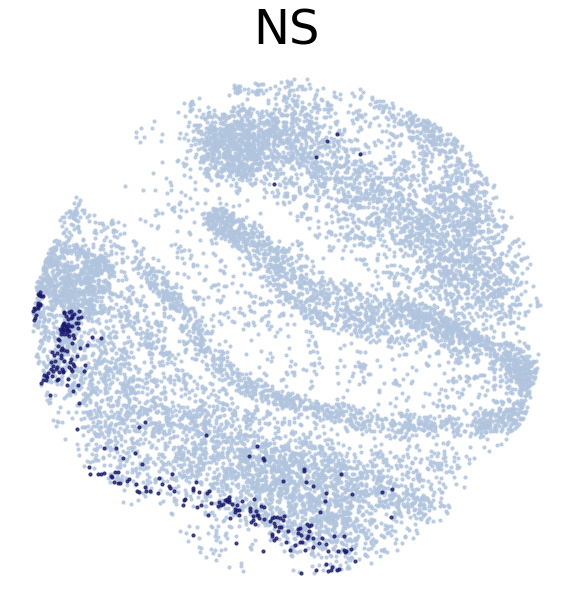

****************
CR
****************
Transfer:


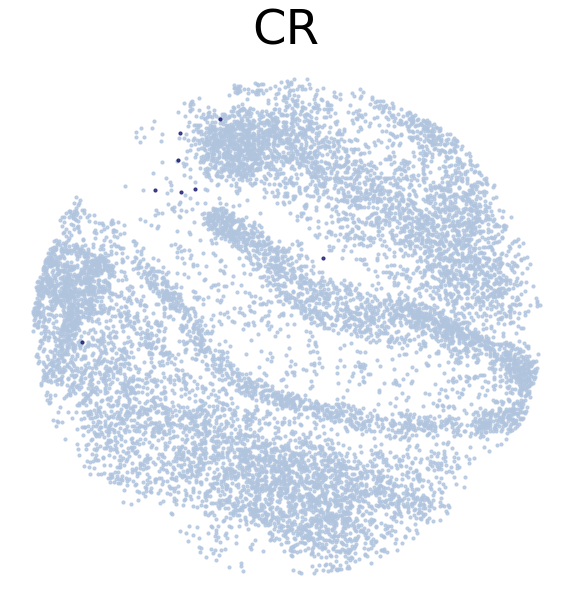

****************
Et
****************
Transfer:


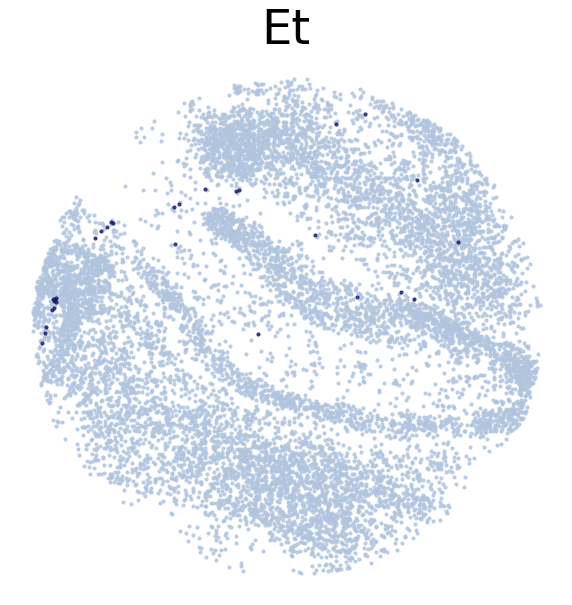

****************
Pl
****************
Transfer:


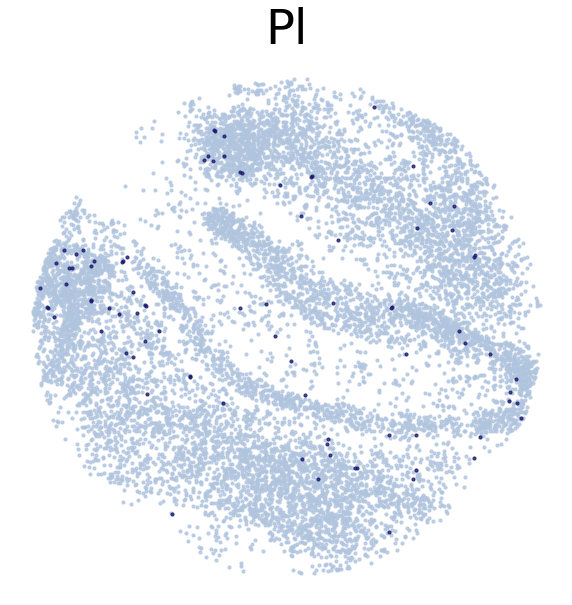

****************
Nr
****************
Transfer:


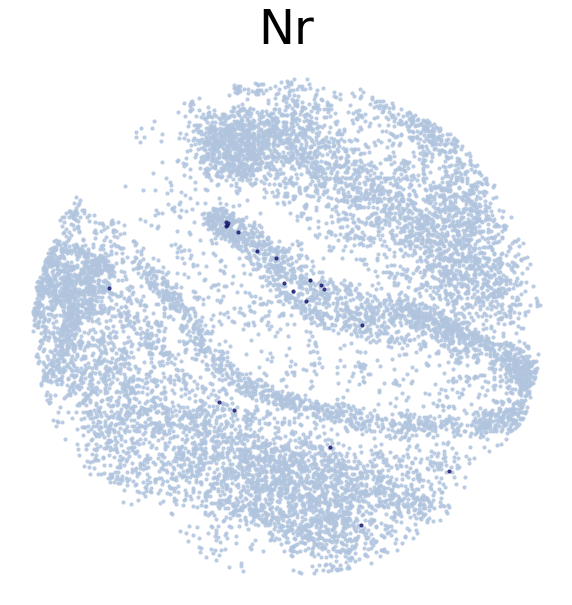

****************
Mr
****************
Transfer:


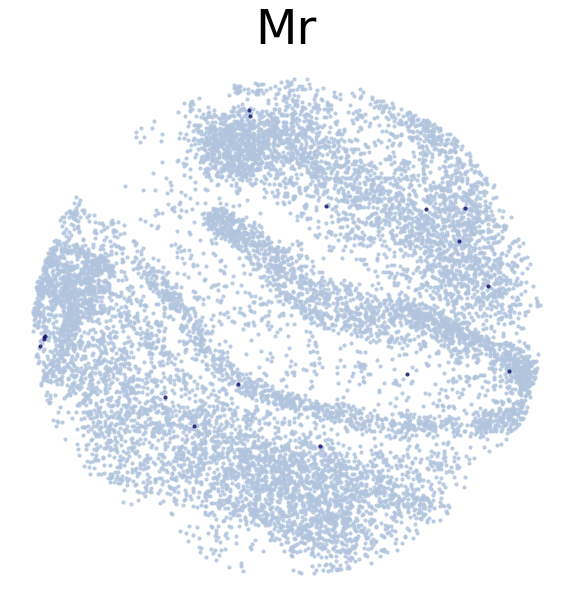

****************
Es
****************
Transfer:


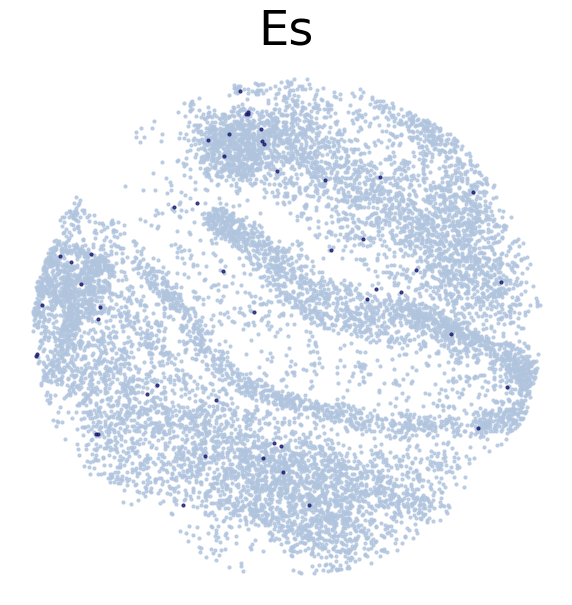

****************
MM
****************
Transfer:


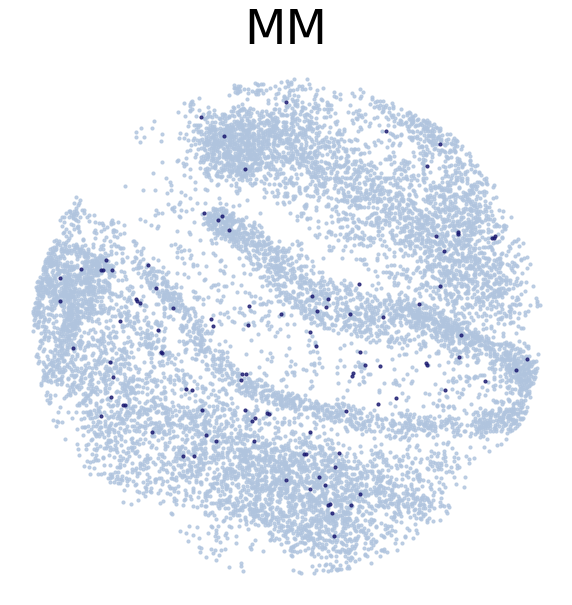

****************
19
****************
Transfer:


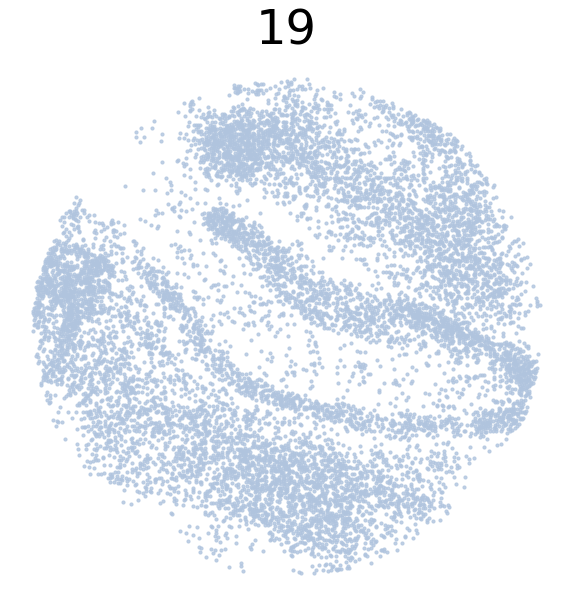

****************
21
****************
Transfer:


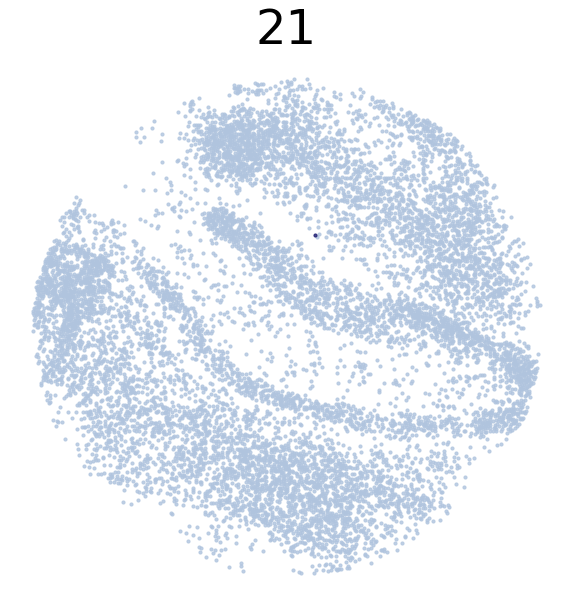

In [49]:
for CT in adata_ref.obs['celltype_1'].unique():
    print('*'*16)
    print(CT)
    print('*'*16)
    print('Transfer:')
    Vis.DrawCT1(adata_ref, CT = CT, s = 10, FM = True, c_name = 'SSV2',
                   x_name = 'xcoord', y_name = 'ycoord',
                   root = 'Transfer1/FM_Valid2/', save = 'HC1')

# Impute

In [4]:
sta = time()

adata_impute = SI.NRD_impute(neighbors, dis, adata_ref, adata_query,
                             ct_name='leiden2', dis_min=0.1, exclude_CTs=None)

end = time()
print((end - sta) / 60, 'min(s)')

0.446270227432251 min(s)


# SVG

In [6]:
JGs = sorted(list(set(adata_ref.var_names).intersection(set(adata_query.var_names))))
adata = adata_ref[:, JGs]

model = SI.Self_Mapping(adata, sparse = True, model_path = 'Model_SI/SI_T1.h5',
                        x_name = 'xcoord', y_name = 'ycoord')

SVA.PrioritizeLPG(adata, Model = model, percent = 0.5, scale_factor = 1e3,
                  Norm = True, x_name = 'xcoord', y_name = 'ycoord')

Trying to set attribute `.obs` of view, copying.


<keras.layers.core.dense.Dense object at 0x7f3618f4bfa0> :
(4, 2)
<keras.layers.core.dense.Dense object at 0x7f3618f4b910> :
(16, 4)
<keras.layers.core.dense.Dense object at 0x7f36190c7520> :
(64, 16)
<keras.layers.core.dense.Dense object at 0x7f3620041400> :
(256, 64)
<keras.layers.core.dense.Dense object at 0x7f36190e97f0> :
(1024, 256)
<keras.layers.core.dense.Dense object at 0x7f3620043e80> :
(4096, 1024)
<keras.layers.core.dense.Dense object at 0x7f3620043bb0> :
(18757, 4096)


In [7]:
adata.var.sort_values('imp_sumup_norm', ascending = False).head()

,n_cells,mt,ERCC,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,imp_sumup,imp_sumup_norm
TTR,13069,False,False,13069,4.758839,67.090552,188983.0,1.664736,1.451109
PCP4,21317,False,False,21317,1.950670,46.321011,77465.0,1.211743,1.056247
TSHZ2,2603,False,False,2603,0.105535,93.445306,4191.0,1.172391,1.021945
CALB2,3967,False,False,3967,0.193392,90.010576,7680.0,1.157161,1.008669
DDN,11454,False,False,11454,0.537268,71.157333,21336.0,1.014310,0.884149


# Pearson's r

In [7]:
cmap = sns.cubehelix_palette(n_colors = 32,start = 2, rot=1.5, as_cmap = True)

def VizCus(df, x_name, x_label, y_name, y_label, c_name = None,
           fontsize = 28, vmin= -0.05, vmax = 0.5, s = 14, save = None):
    
    plt.rcParams['font.size'] = fontsize
    plt.figure(figsize = (12, 8))
    if(c_name == None):
        plt.scatter(df[x_name], df[y_name], s = s)
    elif(vmin!=None):
        plt.scatter(df[x_name], df[y_name], s = s, alpha = 0.7,
                c = df[c_name], vmin = vmin, vmax = vmax, cmap = cmap)
    else:
        plt.scatter(df[x_name], df[y_name], s = s, alpha = 0.7,
                c = df[c_name], cmap = cmap)
    plt.colorbar()
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    
    if(save != None):
        plt.savefig('Transfer1/' + save + '.png',
                    dpi = 128, bbox_inches='tight')

In [20]:
JCs = sorted(list(set(adata_ref.obs_names).intersection(set(adata_impute.obs_names))))

pearson_JGs = pd.DataFrame(np.zeros((len(JGs), 3)), columns = ['gene', 'pearson_r', 'p']) 
pearson_JGs['gene'] = JGs

for i, JG in enumerate(JGs):
    print(i)
    t = stats.pearsonr(adata_impute[JCs, JG].X.flatten(), adata_ref[JCs, JG].X.toarray().flatten())
    pearson_JGs.loc[i, 'pearson_r'] = t[0]
    pearson_JGs.loc[i, 'p'] = t[1]
    clear_output(wait = True)

18756


In [34]:
sc.pp.calculate_qc_metrics(adata, percent_top=None, log1p=False, inplace=True)
adata.var['percent_cell'] = adata.var['n_cells_by_counts'] / adata.shape[0]

t = adata.var[['percent_cell', 'imp_sumup_norm']].reset_index()
t.columns =['gene', 'percent_cell', 'imp_sumup_norm']
pearson_JGs = pearson_JGs.merge(t, how = 'left')

In [35]:
pearson_JGs

,gene,pearson_r,p,percent_cell,imp_sumup_norm
0,0610009E02RIK,-0.001385,0.885880,0.001754,0.003007
1,0610009L18RIK,-0.006417,0.506154,0.008798,0.009758
2,0610009O20RIK,0.001288,0.893822,0.017398,0.010099
3,0610010F05RIK,0.010681,0.268420,0.044329,0.089636
4,0610010K14RIK,-0.000194,0.983997,0.000339,0.002261
...,...,...,...,...,...
18752,ZYG11A,NaN,NaN,0.000085,0.002001
18753,ZYG11B,0.016647,0.084549,0.070554,0.114160
18754,ZYX,0.006892,0.475208,0.032222,0.055223
18755,ZZEF1,0.022464,0.019925,0.029845,0.032561


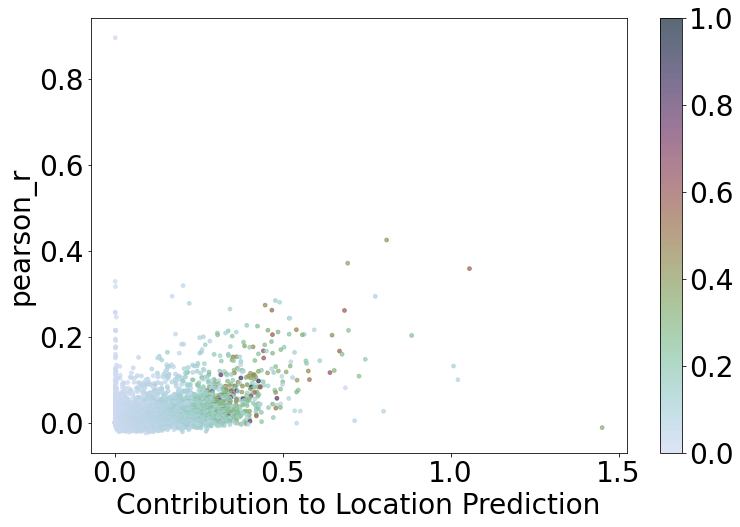

In [12]:
VizCus(pearson_JGs, x_name = 'imp_sumup_norm', x_label = 'Contribution to Location Prediction',
       y_name = 'pearson_r', y_label = 'pearson_r', s = 14, c_name = 'percent_cell',
       vmin = 0, vmax = 1, save = 'Transfer1_imp_r_pcell.png')

In [6]:
#pearson_JGs.sort_values('pearson_r', ascending = False).to_csv('Transfer1/T1_stats.csv', index = None)
pearson_JGs = pd.read_csv('Transfer1/T1_stats.csv')
pearson_JGs.sort_values('pearson_r', ascending = False).head(10)

,gene,pearson_r,p,percent_cell,imp_sumup_norm
0,UBE2V1,0.896169,0.000000e+00,0.000368,0.002100
1,HPCA,0.425150,0.000000e+00,0.417636,0.809686
2,NRGN,0.371162,0.000000e+00,0.377210,0.693814
3,PCP4,0.358520,3.952525e-323,0.559450,1.056247
4,IL1B,0.328629,9.117641e-269,0.000396,0.001968
5,C1QL2,0.319035,1.428428e-252,0.031627,0.203919
6,ANXA8,0.316621,1.375154e-248,0.000764,0.002830
7,SPINK8,0.294257,1.984329e-213,0.025178,0.171491
8,CRYM,0.293956,5.634543e-213,0.092025,0.775895
9,WIPF3,0.284188,1.350349e-198,0.140032,0.478503


In [7]:
pearson_JGs[pearson_JGs['pearson_r']<0.1].sort_values('imp_sumup_norm', ascending = False).head(10)

,gene,pearson_r,p,percent_cell,imp_sumup_norm
18073,TTR,-0.011584,2.300563e-01,0.343206,1.451109
216,TSHZ2,0.099888,3.218413e-25,0.069252,1.021945
1824,SST,0.026450,6.126600e-03,0.078446,0.800536
6755,NPY,0.004477,6.427751e-01,0.066367,0.714476
322,MYL4,0.081183,3.604988e-17,0.023197,0.686857
1785,GFAP,0.026902,5.307989e-03,0.056126,0.552626
359,RAB3C,0.075802,3.690822e-15,0.240120,0.546827
221,ITM2C,0.098931,9.111510e-25,0.393986,0.543162
13129,GAD2,-0.001355,8.883230e-01,0.051685,0.541848
397,NRSN1,0.071386,1.305927e-13,0.305016,0.541768


# Visualize

********************************
NRGN
********************************
ST2 Transfer:


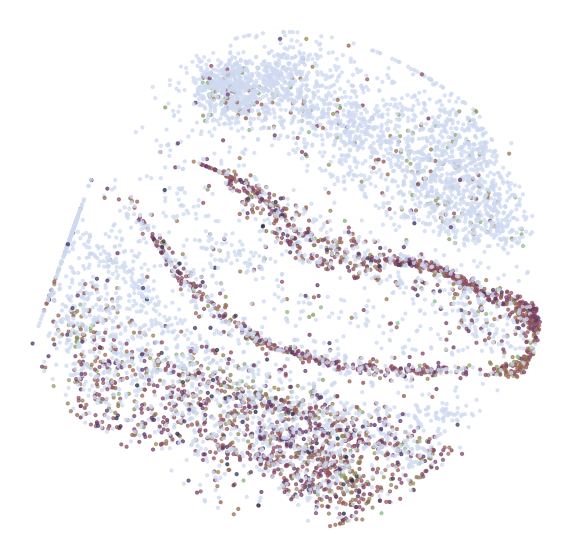

ST2:


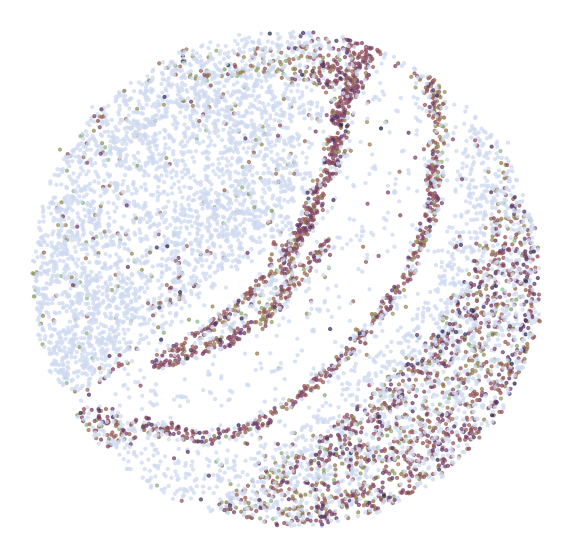

ST1:


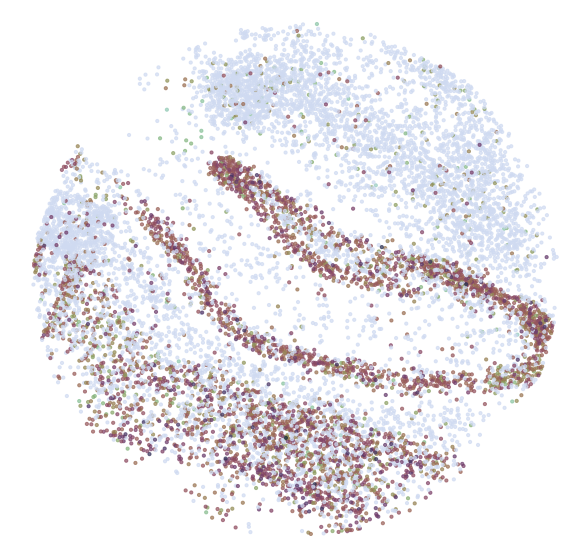

Imputed ST1:


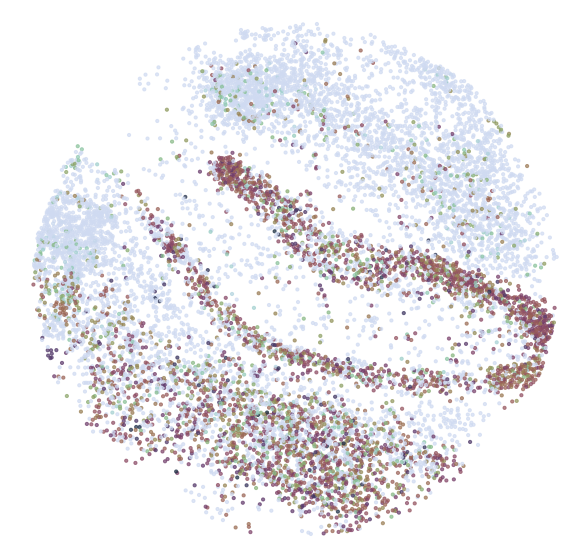

********************************
PCP4
********************************
ST2 Transfer:


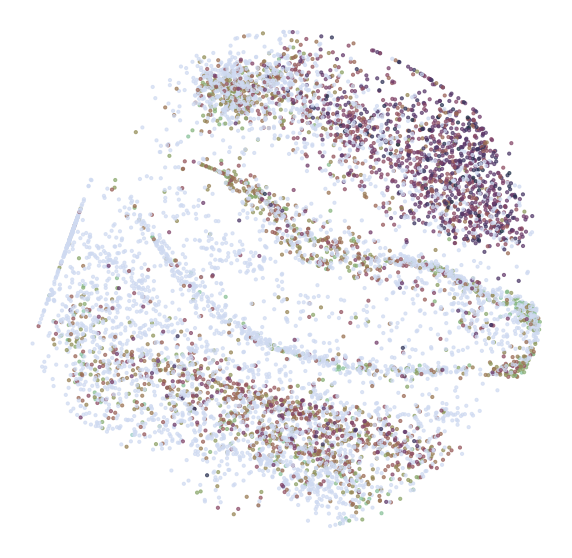

ST2:


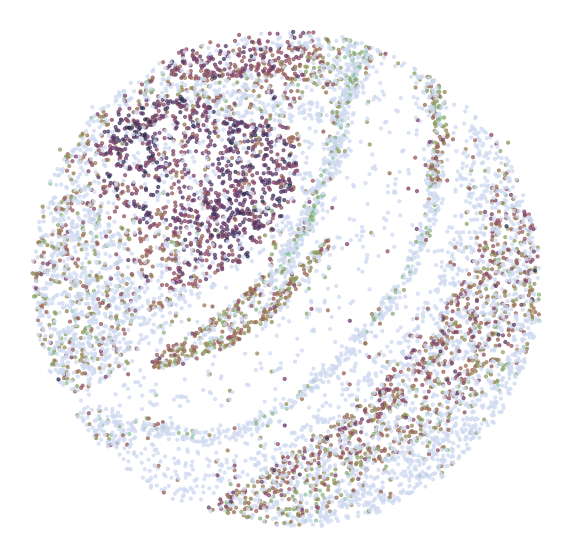

ST1:


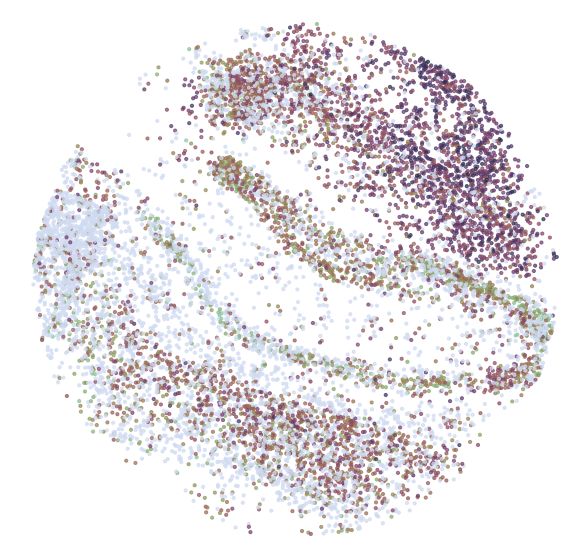

Imputed ST1:


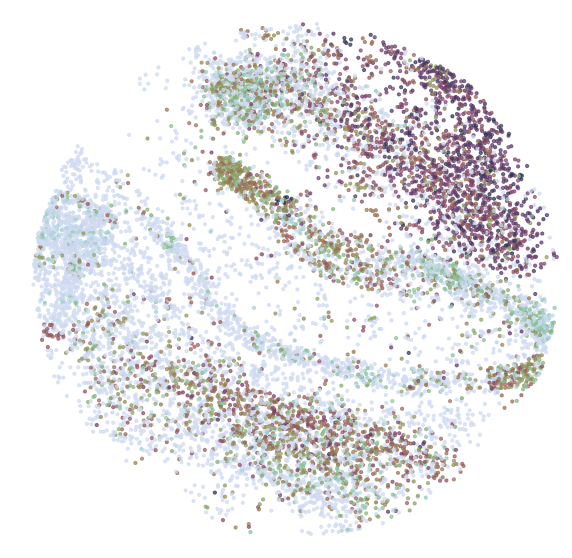

********************************
HPCA
********************************
ST2 Transfer:


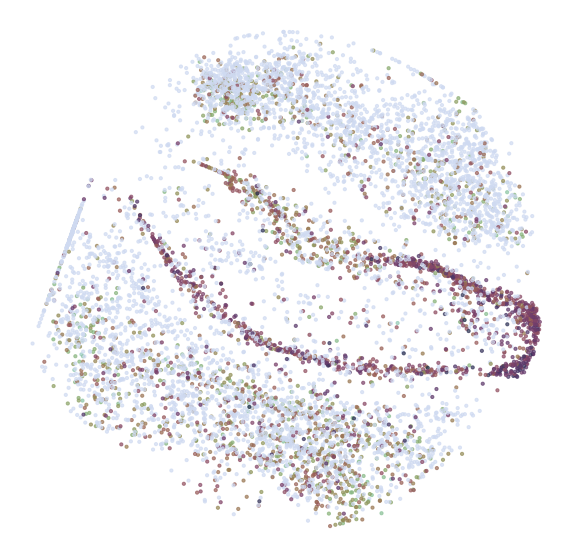

ST2:


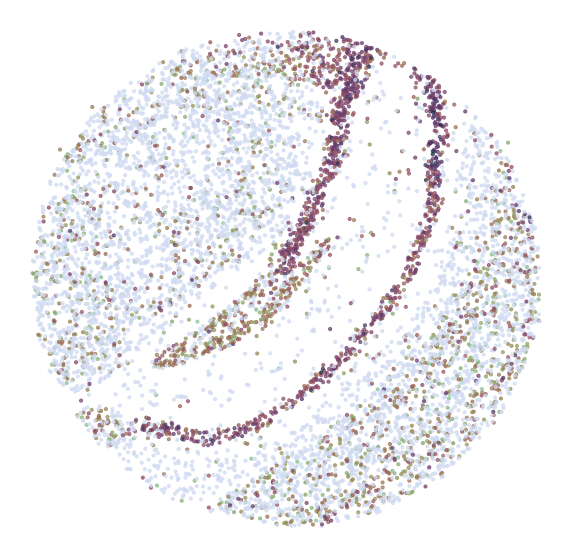

ST1:


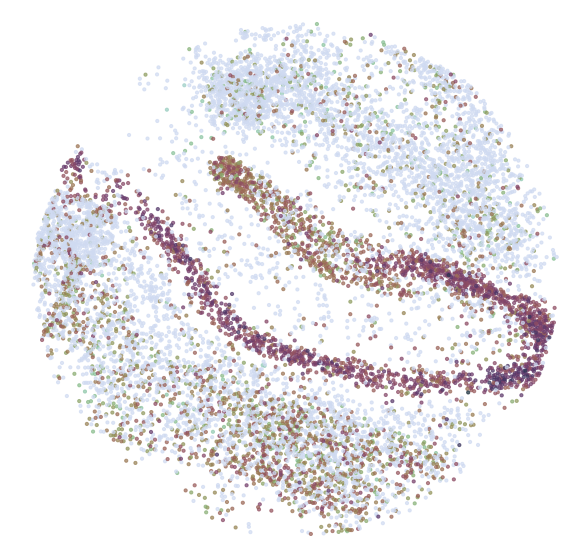

Imputed ST1:


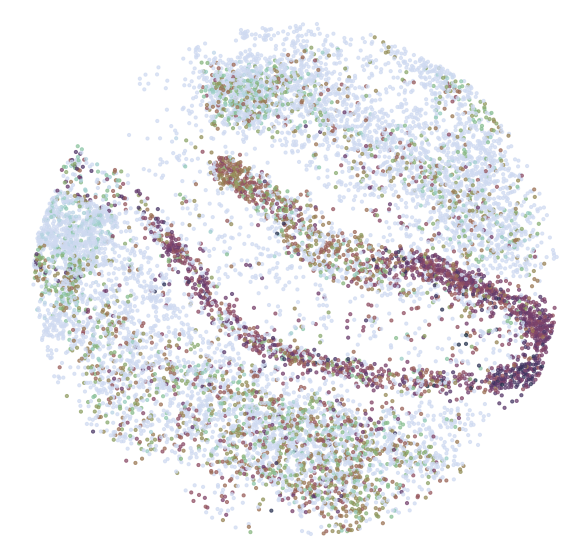

********************************
SPINK8
********************************
ST2 Transfer:


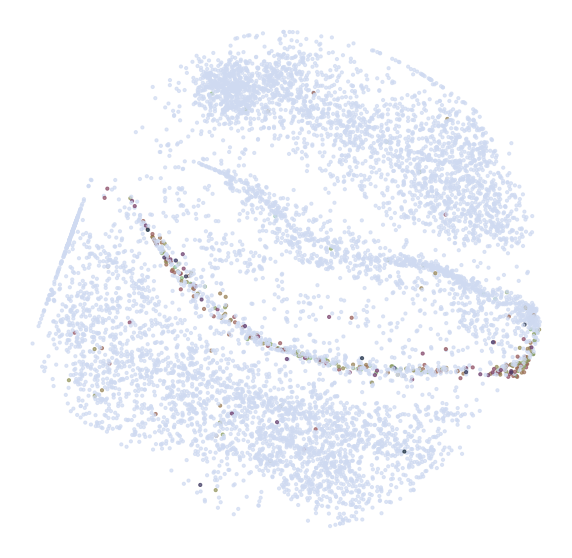

ST2:


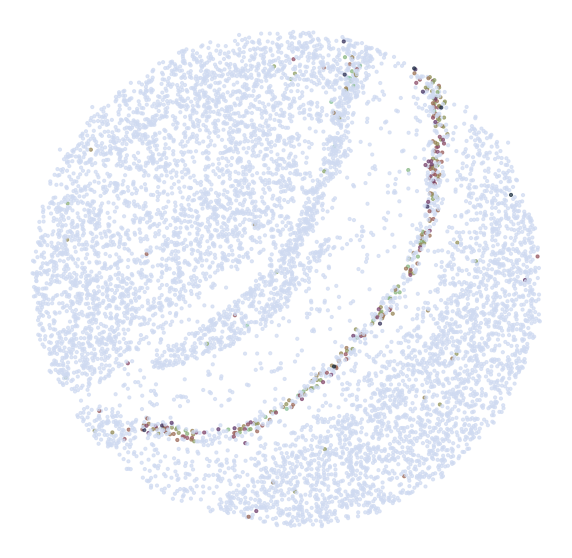

ST1:


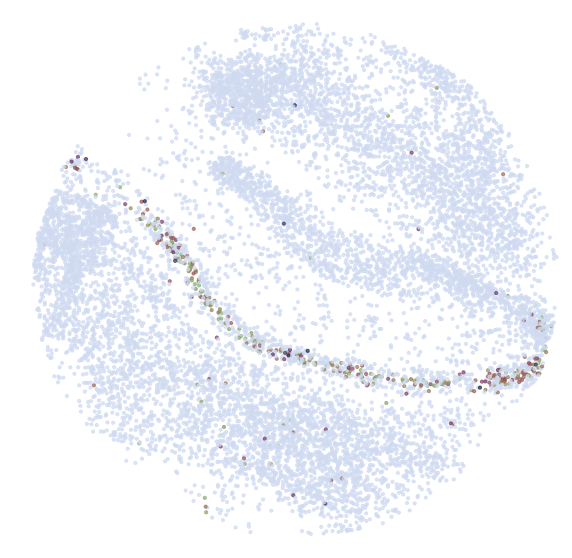

Imputed ST1:


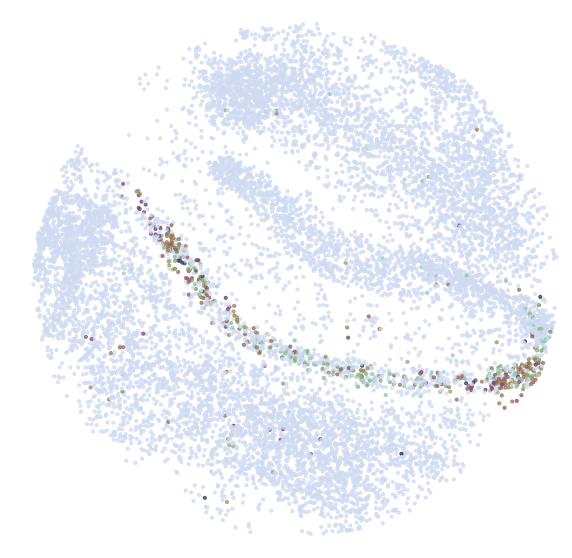

********************************
C1QL2
********************************
ST2 Transfer:


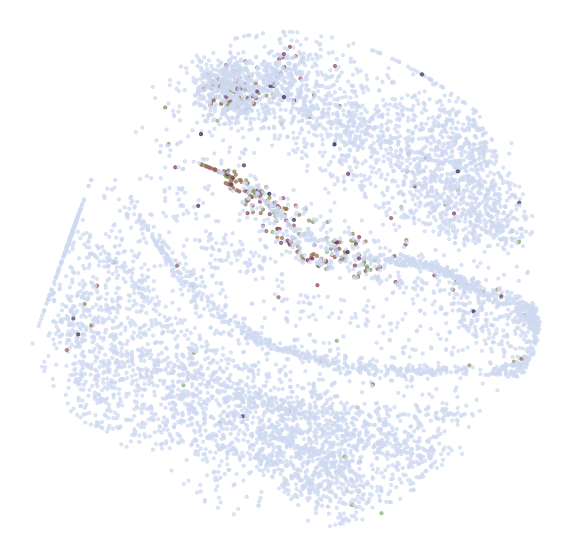

ST2:


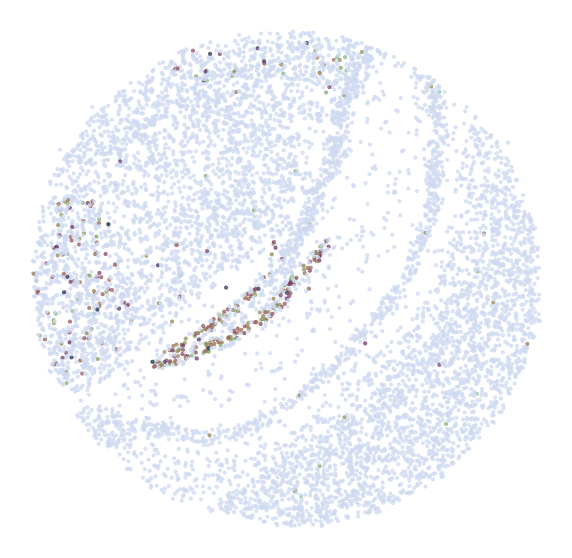

ST1:


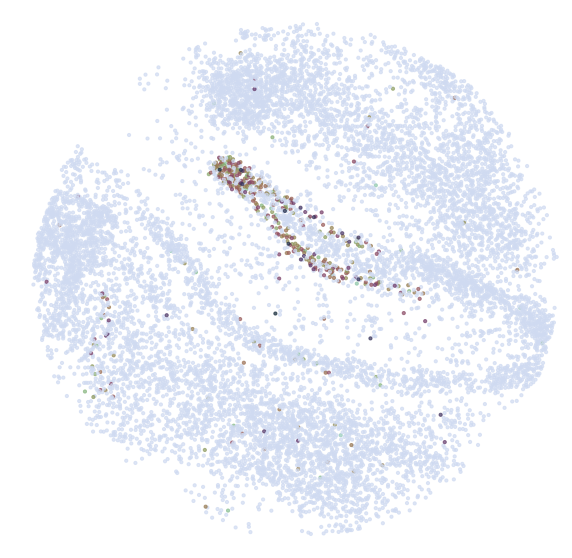

Imputed ST1:


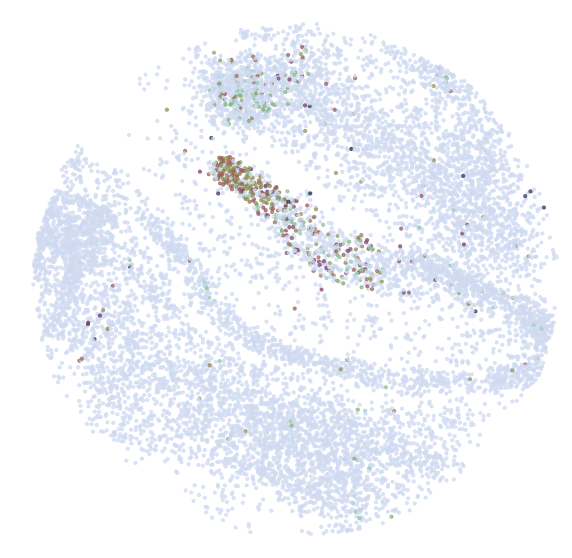

In [9]:
cmap = sns.cubehelix_palette(n_colors = 32,start = 2, rot=1.5, as_cmap = True)
#cmap = 'magma'

GeneInfo = pd.read_csv('GeneInfo_DS_CTS.csv', index_col = 0)

GLs = pearson_JGs[pearson_JGs['percent_cell']>0.01].sort_values('pearson_r', ascending = False)['gene'][:5]

s = 10
    
GLs = list(set(GLs))

for gene in GLs:
    print('*'*32)
    print(gene)
    print('*'*32)
    print('ST2 Transfer:')
    Vis.DrawGenes2(adata_query, gene = gene, lim = False, xlim = [650, 5750],
                   ylim = [650, 5750], cmap = cmap, FM = True, CTL = None,
                   c_name = 'leiden2', root = 'Transfer1/FM_Valid1/',
                   s = s, coords_name = 'spatial_mapping',
                   title = False, save = 'HC2_Transfer')
    print('ST2:')
    Vis.DrawGenes2(adata_query, gene = gene, lim = False, xlim = [650, 5750],
                   ylim = [650, 5750], cmap = cmap, FM = True, CTL = None,
                   c_name = 'leiden2', root = 'Transfer1/FM_Valid1/',
                   s = s, coords_name = 'spatial',
                   title = False, save = 'HC2')
    print('ST1:')
    Vis.DrawGenes2(adata_ref, gene = gene, lim = True, xlim = [650, 5750],
                   ylim = [650, 5750], cmap = cmap, FM = True, CTL = None,
                   c_name = 'SSV2', root = 'Transfer1/FM_Valid1/', 
                   s = s, coords_name = 'spatial',
                   title = False, save = 'HC1')
    print('Imputed ST1:')
    Vis.DrawGenes2(adata_impute, gene = gene, lim = True, xlim = [650, 5750], ylim = [650, 5750],
                   cmap = cmap, FM = True, CTL = None, c_name = 'SSV2', root = 'Transfer1/FM_Valid1/', 
                   s = s, coords_name = 'spatial', title = False, save = 'HC1_Impute')

********************************
TTR
********************************
ST2 Transfer:


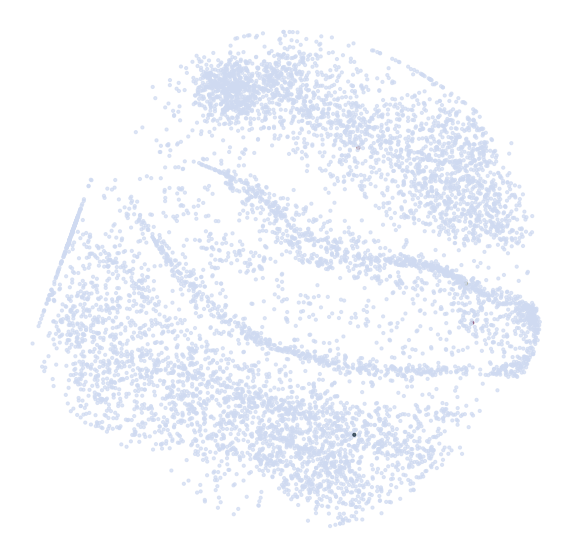

ST2:


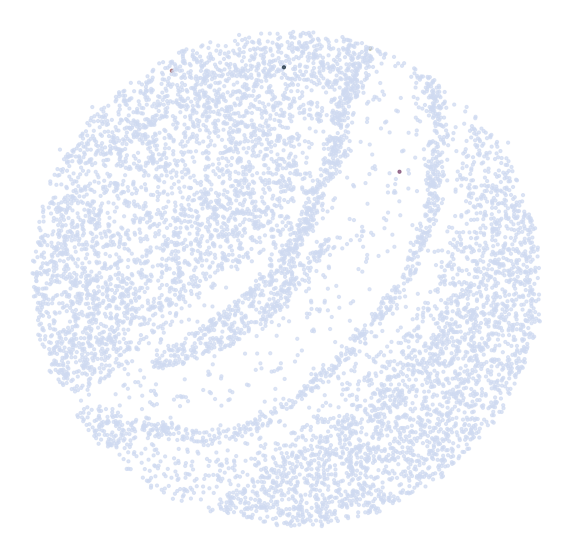

ST1:


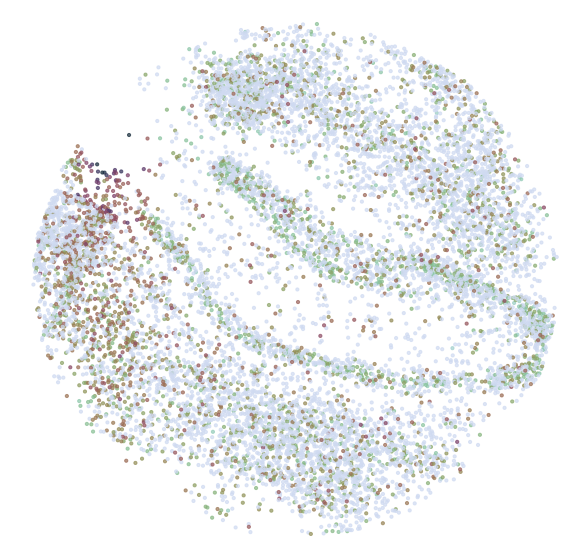

Imputed ST1:


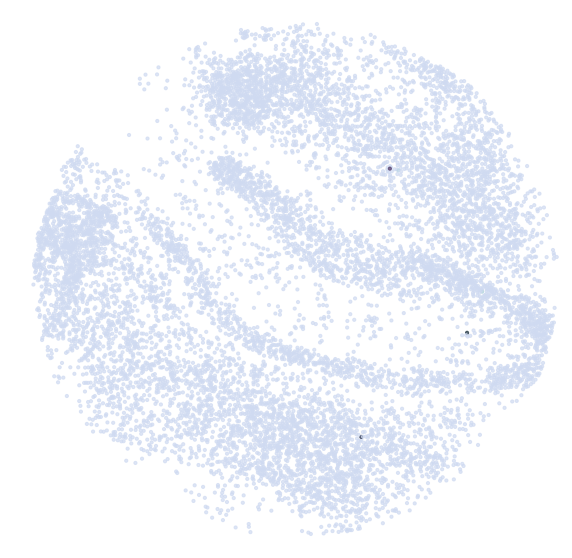

********************************
MYL4
********************************
ST2 Transfer:


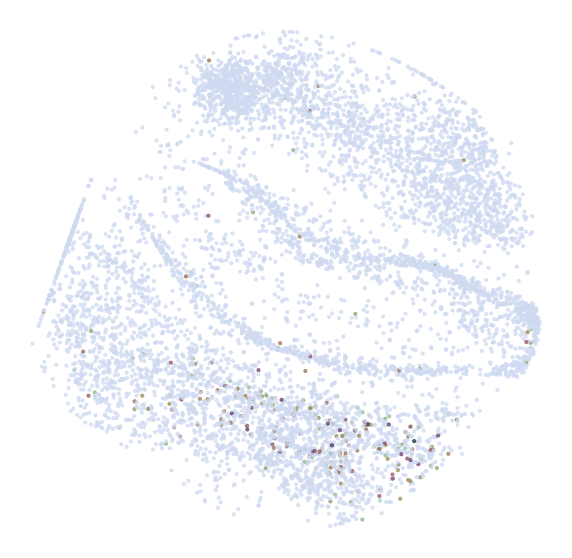

ST2:


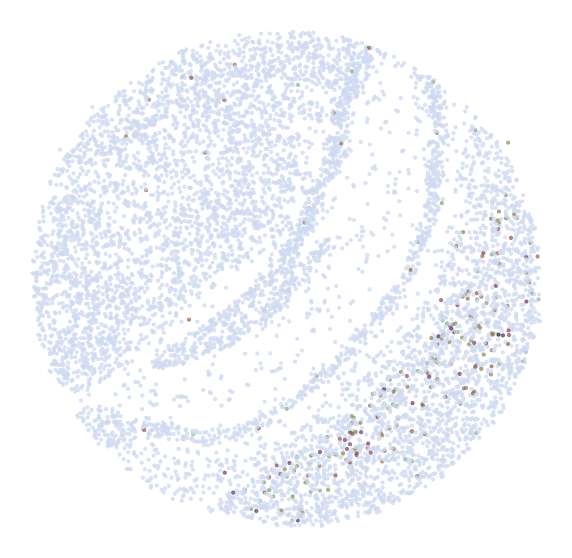

ST1:


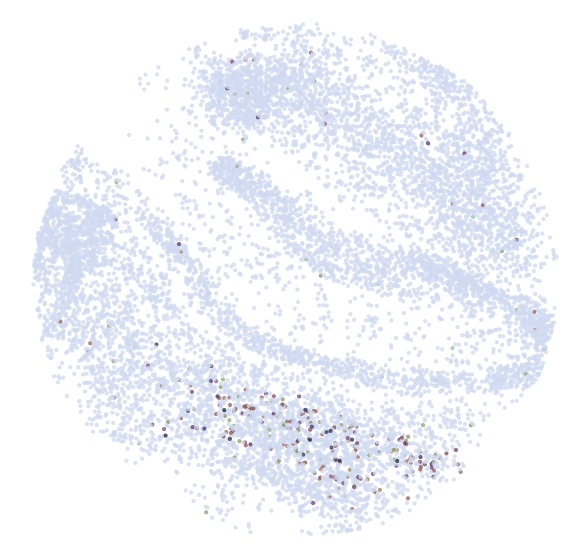

Imputed ST1:


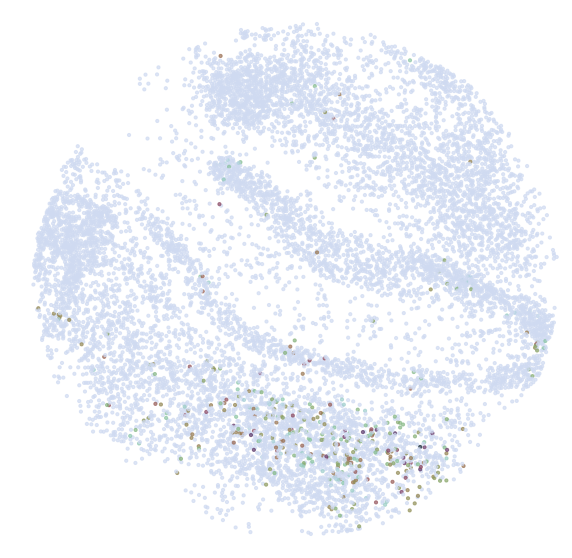

********************************
TSHZ2
********************************
ST2 Transfer:


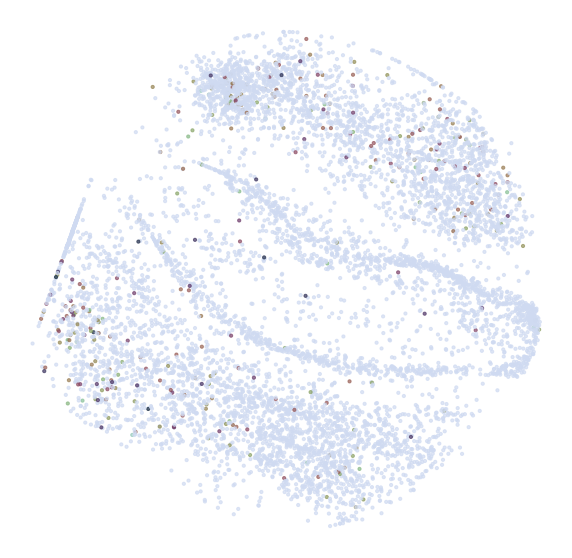

ST2:


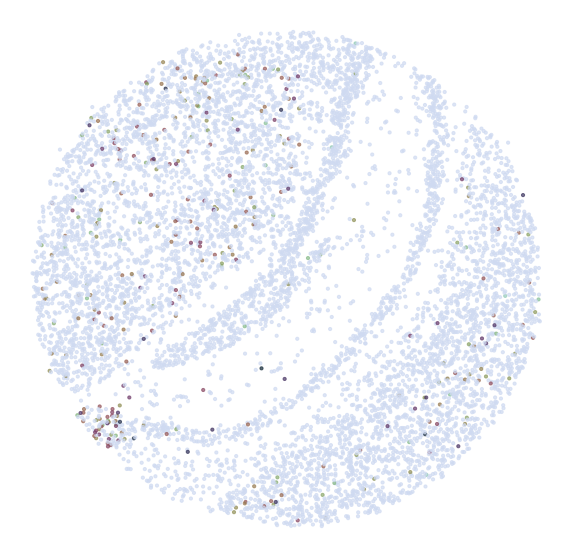

ST1:


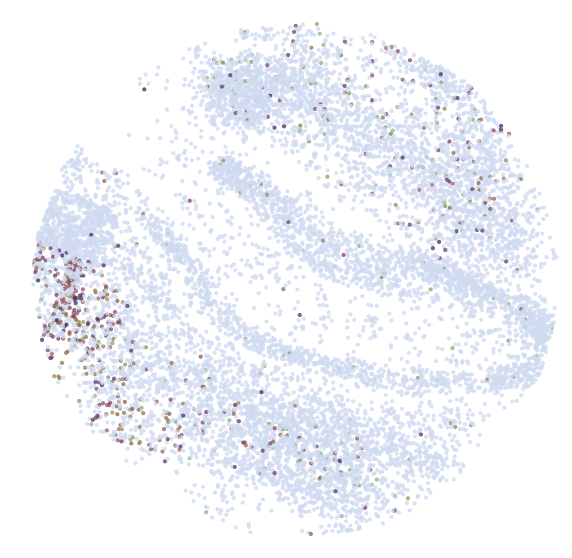

Imputed ST1:


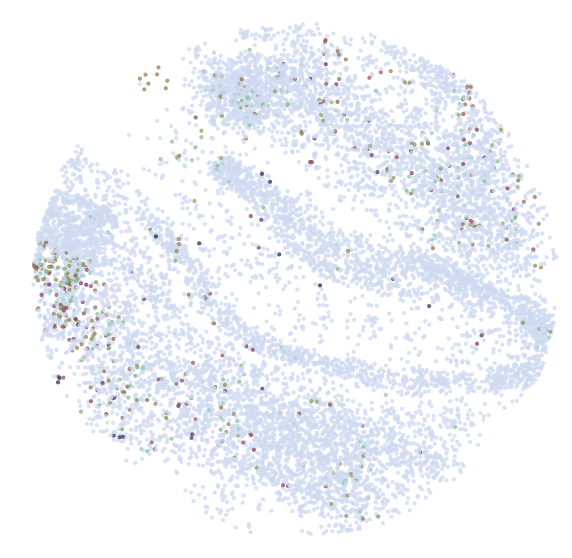

********************************
SST
********************************
ST2 Transfer:


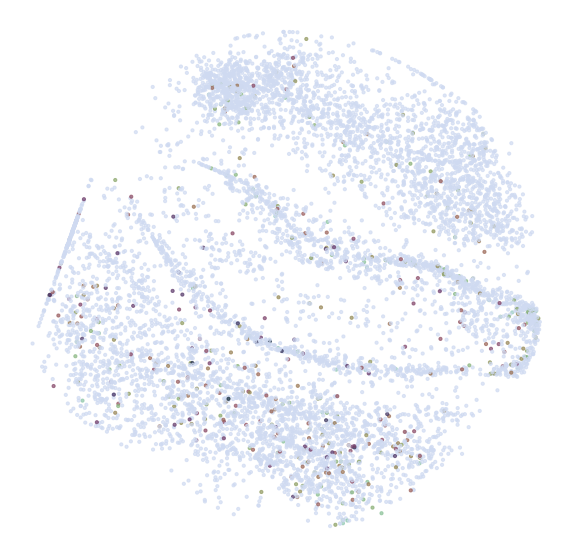

ST2:


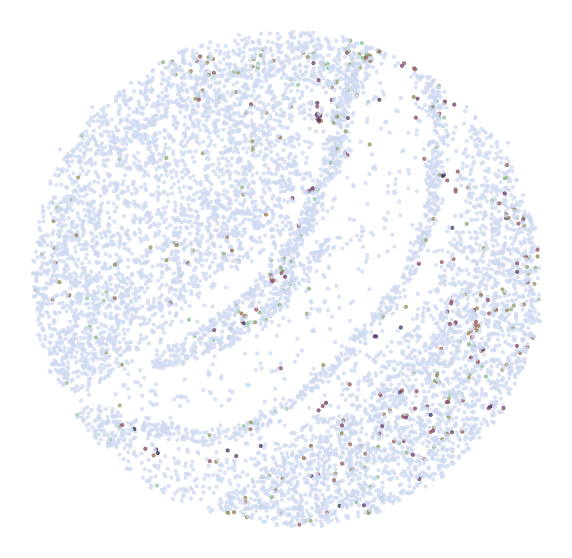

ST1:


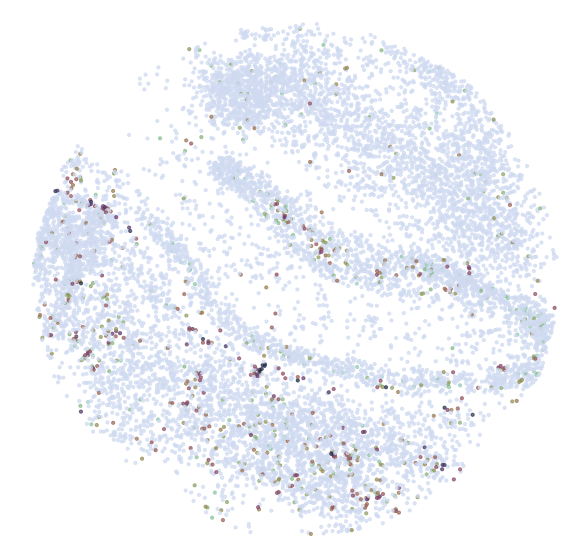

Imputed ST1:


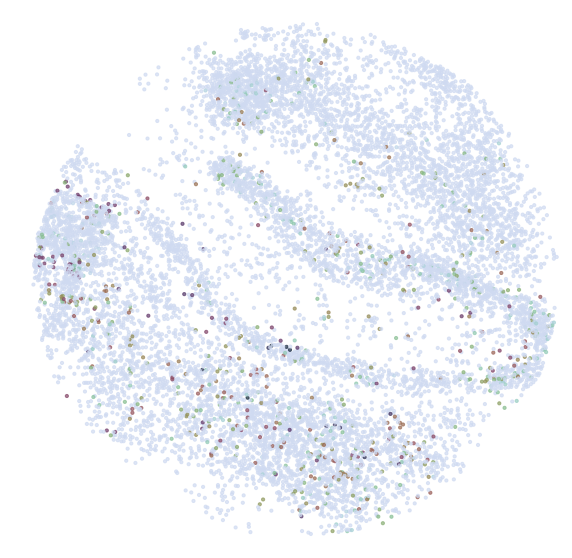

********************************
NPY
********************************
ST2 Transfer:


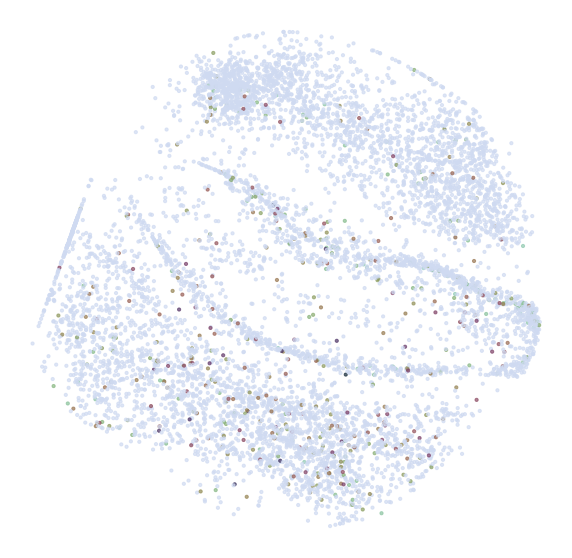

ST2:


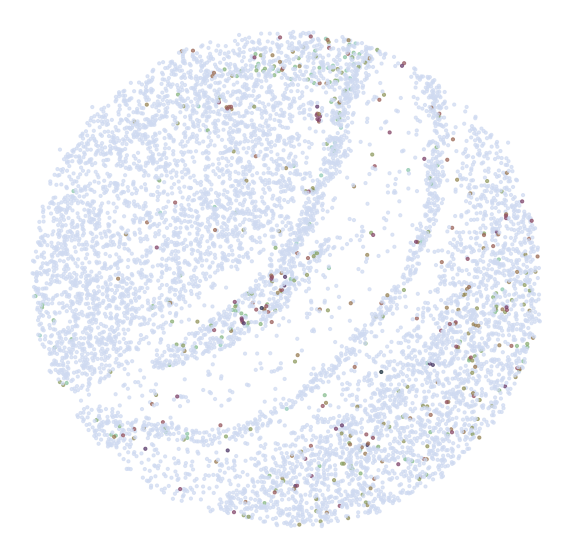

ST1:


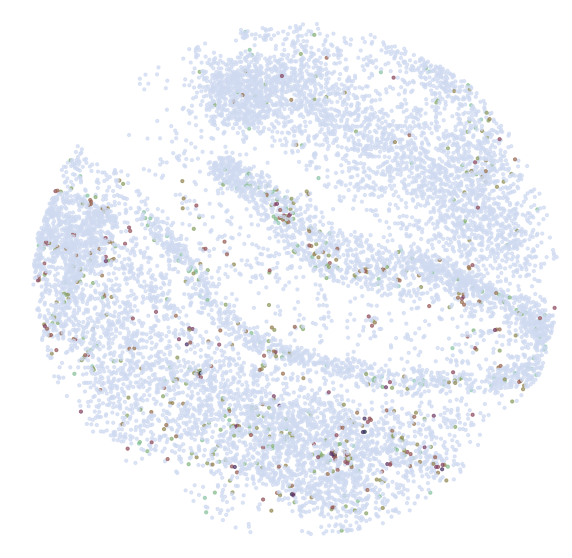

Imputed ST1:


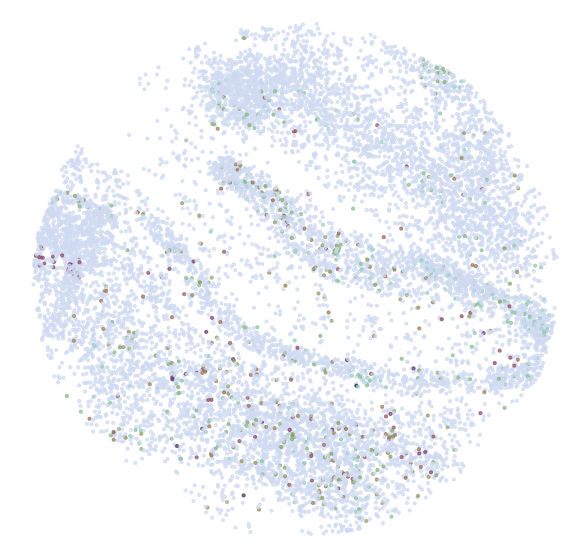

In [15]:
cmap = sns.cubehelix_palette(n_colors = 32,start = 2, rot=1.5, as_cmap = True)

GeneInfo = pd.read_csv('GeneInfo_DS_CTS.csv', index_col = 0)

GLs = pearson_JGs[pearson_JGs['pearson_r']<0.1].sort_values('imp_sumup_norm', ascending = False)['gene'][:5]

s = 10
    
GLs = list(set(GLs))

for gene in GLs:
    print('*'*32)
    print(gene)
    print('*'*32)
    print('ST2 Transfer:')
    Vis.DrawGenes2(adata_query, gene = gene, lim = False, xlim = [650, 5750],
                   ylim = [650, 5750], cmap = cmap, FM = True, CTL = None,
                   c_name = 'leiden2', root = 'Transfer1/FM_Valid3/',
                   s = s, x_name = 'x_transfer', y_name = 'y_transfer',
                   title = False, save = 'HC2_Transfer')
    print('ST2:')
    Vis.DrawGenes2(adata_query, gene = gene, lim = False, xlim = [650, 5750],
                   ylim = [650, 5750], cmap = cmap, FM = True, CTL = None,
                   c_name = 'leiden2', root = 'Transfer1/FM_Valid3/',
                   s = s, x_name = 'xcoord', y_name = 'ycoord',
                   title = False, save = 'HC2')
    print('ST1:')
    Vis.DrawGenes2(adata_ref, gene = gene, lim = True, xlim = [650, 5750],
                   ylim = [650, 5750], cmap = cmap, FM = True, CTL = None,
                   c_name = 'SSV2', root = 'Transfer1/FM_Valid3/', 
                   s = s, x_name = 'xcoord', y_name = 'ycoord',
                   title = False, save = 'HC1')
    print('Imputed ST1:')
    Vis.DrawGenes2(adata_impute, gene = gene, lim = True, xlim = [650, 5750], ylim = [650, 5750],
                   cmap = cmap, FM = True, CTL = None, c_name = 'SSV2', root = 'Transfer1/FM_Valid3/', 
                   s = s, x_name = 'xcoord', y_name = 'ycoord', title = False, save = 'HC1_Impute')